In [1]:
import csv
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import ticker
from matplotlib.ticker import (AutoMinorLocator, MultipleLocator)

from scipy.stats import zscore
from sklearn.impute import KNNImputer
from scipy.spatial import distance
from scipy.interpolate import interp1d
from scipy import stats
from scipy.stats import chi2
from scipy.spatial.distance import mahalanobis

In [2]:
from pathlib import Path
print(Path.cwd())

from os import walk

#This is the folder path, replace to your own local path
dir_path = r'C:\Users\Sang\OneDrive - Harvard University\CGBC\DataRelease\Sang_Code_Processing_2024\0. Raw data\Year 4Final\Desigo\Zone temperature'

file_list = []
for (dir_path, dir_names, file_names) in walk(dir_path):
    file_list.extend(file_names)
    # don't look inside any subdirectory
    break
print(file_list)

c:\Users\Sang\OneDrive - Harvard University\CGBC\DataRelease\Final_Processing_Code_2024\Code Year4
['HZ_Z11_temp_060123-053124_raw.csv', 'HZ_Z12+13_temp_060123-053124_raw.csv', 'HZ_Z14_temp_060123-053124_raw.csv', 'HZ_Z15+16_temp_060123-053124_raw.csv', 'HZ_Z17_temp_060123-053124_raw.csv', 'HZ_Z1_temp_060123-053124_raw.csv', 'HZ_Z21_temp_060123-053124_raw.csv', 'HZ_Z22+23_temp_060123-053124_raw.csv', 'HZ_Z24_temp_060123-053124_raw.csv', 'HZ_Z25+26+27_temp_060123-053124_raw.csv', 'HZ_Z2_temp_060123-053124_raw.csv', 'HZ_Z31_temp_060123-053124_raw.csv', 'HZ_Z32_temp_060123-053124_raw.csv', 'HZ_Z33_temp_060123-053124_raw.csv', 'HZ_Z3_temp_060123-053124_raw.csv', 'HZ_Z4_temp_060123-053124_raw.csv', 'HZ_Z5_temp_060123-053124_raw.csv']


In [3]:
#IMPORTANT: If you get an error in reading the files do the following:
import os
Lst = []
for i in range(0, len(file_list)):
    # Construct the full path for each file
    file_path = os.path.join(dir_path, file_list[i])
    # Use the full path to read the CSV file
    data = pd.read_csv(file_path, parse_dates=['Timestamp'], index_col=[0])
    filtered_df = data[data['QualityGood'] == True]
    print(len(filtered_df))
    Lst.append(filtered_df)

527278
527260
527277
527277
527277
527277
527277
527277
527277
527277
527278
527277
527276
527276
527278
527276
527278


In [4]:
Lst_Temp = []
Lst_name = []
#Initialize an empty DataFrame to compile resampled data from each DataFrame in Lst
Zone_Temp = pd.DataFrame()
res = 1
#This part will take care of timestamp corrections, ensuring the output is always EST!
for i in range(0,len(Lst)):
    #Convert the index of the current DataFrame to datetime format with UTC timezone (remove format=mixed if error is observed)    
    Lst[i].index = pd.to_datetime(Lst[i].index, errors='coerce', utc=True, format='mixed')
    #Convert the timezone of the index from UTC to US/Eastern
    Lst[i].index = Lst[i].index.tz_convert('US/Eastern')
    #Resample the DataFrame to a 1-minute frequency using the mean for aggregation. (This is for analysis)
    #forward fill missing data resulting from the resampling.
    Lst[i] = Lst[i].resample("1T").mean().ffill()
    #Extract the name of the first column of the DataFrame.    
    zone_name = Lst[i].columns.values[0]
    Lst_name.append(zone_name)
    #Convert the specified column's data to numeric to ensure consistency for calculations.
    Z = pd.to_numeric(Lst[i][zone_name])
    Lst_Temp.append(Z.tolist())
    #Create a new column in 'Zone_DF' with the name of the current zone.
    Zone_Temp[zone_name] = pd.Series(Z, index=Lst[i].index)
    
Zone_Temp

C:\Users\Sang\AppData\Local\Temp\ipykernel_34868\836866833.py:14: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  Lst[i] = Lst[i].resample("1T").mean().ffill()
C:\Users\Sang\AppData\Local\Temp\ipykernel_34868\836866833.py:14: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  Lst[i] = Lst[i].resample("1T").mean().ffill()
C:\Users\Sang\AppData\Local\Temp\ipykernel_34868\836866833.py:14: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  Lst[i] = Lst[i].resample("1T").mean().ffill()
C:\Users\Sang\AppData\Local\Temp\ipykernel_34868\836866833.py:14: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  Lst[i] = Lst[i].resample("1T").mean().ffill()
C:\Users\Sang\AppData\Local\Temp\ipykernel_34868\836866833.py:14: FutureWarning: 'T' is deprecated and will be removed in a future version, plea

,Z11_temp,Z12+13_temp,Z14_temp,Z15+16_temp,Z17_temp,Z1_temp,Z21_temp,Z22+23_temp,Z24_temp,Z25+26+27_temp,Z2_temp,Z31_temp,Z32_temp,Z33_temp,Z3_temp,Z4_temp,Z5_temp
Timestamp,,,,,,,,,,,,,,,,,
2023-06-01 00:00:00-04:00,22.780001,23.600000,21.719999,22.980000,22.940001,23.280001,23.420000,23.000000,23.50,23.360001,25.620001,24.020000,24.040001,23.760000,22.820000,23.100000,21.660000
2023-06-01 00:01:00-04:00,22.740000,23.600000,21.719999,22.980000,22.940001,23.280001,23.420000,23.000000,23.50,23.360001,25.620001,24.020000,24.040001,23.760000,22.820000,23.100000,21.660000
2023-06-01 00:02:00-04:00,22.740000,23.600000,21.719999,22.980000,22.940001,23.280001,23.420000,23.000000,23.50,23.360001,25.580000,24.020000,24.040001,23.760000,22.820000,23.100000,21.660000
2023-06-01 00:03:00-04:00,22.740000,23.600000,21.719999,22.980000,22.940001,23.280001,23.420000,23.000000,23.50,23.360001,25.580000,24.100000,24.040001,23.760000,22.820000,23.100000,21.660000
2023-06-01 00:04:00-04:00,22.740000,23.500000,21.700001,22.980000,22.920000,23.240000,23.459999,22.959999,23.50,23.260000,25.580000,24.080000,24.020000,23.719999,22.799999,23.100000,21.660000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-31 23:55:00-04:00,20.920000,21.520000,19.660000,20.840000,20.209999,20.160000,21.260000,20.959999,22.02,21.700001,23.719999,22.840000,22.180000,22.219999,20.500000,20.320000,20.799999
2024-05-31 23:56:00-04:00,20.920000,21.520000,19.660000,20.840000,20.379999,20.160000,21.260000,20.959999,22.02,21.700001,23.719999,22.840000,22.180000,22.219999,20.500000,20.500000,20.799999
2024-05-31 23:57:00-04:00,20.840000,21.540001,19.620001,20.879999,20.379999,20.150000,21.219999,20.959999,22.02,21.700001,23.719999,22.780001,22.160000,22.200001,20.559999,20.639999,20.799999


In [5]:
#Print the column names to check
Zone_Temp.columns.values

array(['Z11_temp', 'Z12+13_temp', 'Z14_temp', 'Z15+16_temp', 'Z17_temp',
       'Z1_temp', 'Z21_temp', 'Z22+23_temp', 'Z24_temp', 'Z25+26+27_temp',
       'Z2_temp', 'Z31_temp', 'Z32_temp', 'Z33_temp', 'Z3_temp',
       'Z4_temp', 'Z5_temp'], dtype=object)

<Axes: xlabel='Timestamp'>

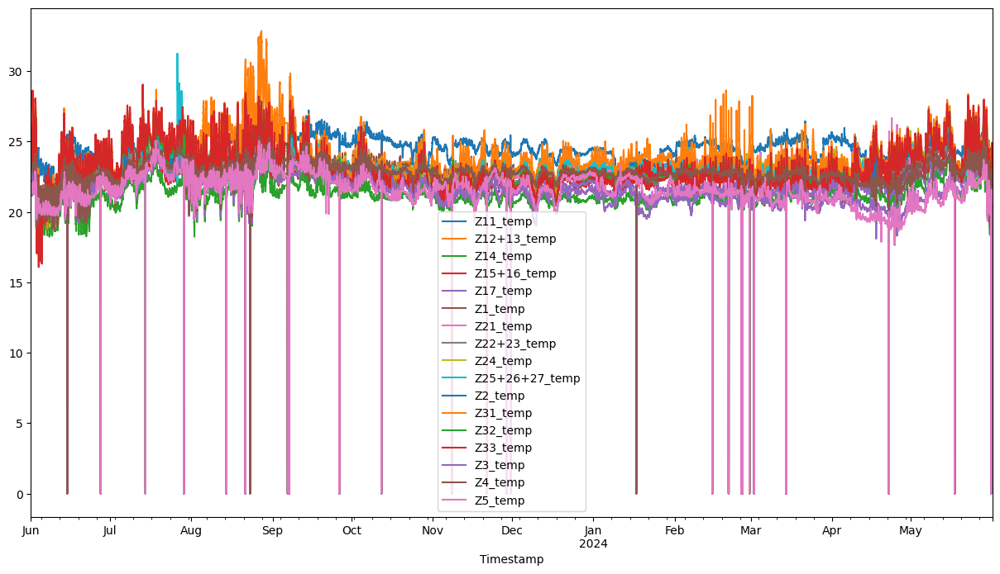

In [6]:
Zone_Temp.plot(figsize=(15, 8))

In [7]:
print(Zone_Temp.index.min(), Zone_Temp.index.max())

2023-06-01 00:00:00-04:00 2024-05-31 23:59:00-04:00


In [8]:
#Initialize lists for storing differences and names (Difference Analysis)
Lst_diff = []
Lst_name = []
#Loop through each DataFrame to calculate and store differences in data.
for i in range(0,len(Lst)):
    zone_name = Lst[i].columns.values[0]
    Lst_name.append(zone_name)
    Z = pd.to_numeric(Lst[i][zone_name])
    #Calculate the difference between consecutive data points.
    temp = Z.diff()
    #Store the differences, excluding the last one, and sorting to facilitate analysis (2000 most significant differences).
    Lst_diff.append(temp.sort_values(ascending=True)[-200:-1].tolist())
    
# print (Lst_diff)
#Restructure the dataframe for visual analysis
df = pd.DataFrame(Lst_diff).transpose()

df.columns = Lst_name
df   

,Z11_temp,Z12+13_temp,Z14_temp,Z15+16_temp,Z17_temp,Z1_temp,Z21_temp,Z22+23_temp,Z24_temp,Z25+26+27_temp,Z2_temp,Z31_temp,Z32_temp,Z33_temp,Z3_temp,Z4_temp,Z5_temp
0,0.180000,0.180000,0.100000,0.160000,0.180000,0.260000,0.219999,0.179998,0.180000,0.200001,0.10,0.180000,0.160000,0.200001,0.219999,0.240000,0.240000
1,0.180000,0.180000,0.100000,0.160000,0.180000,0.260000,0.219999,0.179998,0.180000,0.200001,0.10,0.180000,0.160000,0.200001,0.219999,0.240000,0.240000
2,0.180000,0.180000,0.100000,0.160000,0.180000,0.260000,0.219999,0.179998,0.180000,0.200001,0.10,0.180000,0.160000,0.200001,0.219999,0.240000,0.240000
3,0.180000,0.180000,0.100000,0.160000,0.180000,0.260000,0.219999,0.179998,0.180000,0.200001,0.10,0.180000,0.160000,0.200001,0.219999,0.240000,0.240000
4,0.180000,0.180000,0.100000,0.160000,0.180000,0.260000,0.219999,0.179998,0.180000,0.200001,0.10,0.180000,0.160000,0.200001,0.219999,0.240000,0.240000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
194,23.500000,24.200001,21.180000,22.920000,22.980000,23.879999,23.900000,24.020000,24.420000,23.920000,23.68,24.299999,24.280001,24.299999,22.180000,23.320000,22.160000
195,23.660000,24.280001,21.200001,23.040001,23.320000,23.920000,24.160000,24.139999,24.780001,24.740000,23.74,24.480000,24.660000,24.320000,22.360001,23.340000,22.780001
196,23.680000,24.379999,21.219999,23.219999,23.559999,24.059999,24.959999,24.180000,25.240000,25.040001,24.58,25.120001,25.420000,24.459999,23.120001,23.840000,23.000000
197,23.959999,24.400000,21.540001,23.260000,23.700001,24.139999,25.059999,24.459999,25.260000,25.040001,24.92,25.620001,25.440001,25.580000,23.240000,24.200001,23.299999


<Axes: >

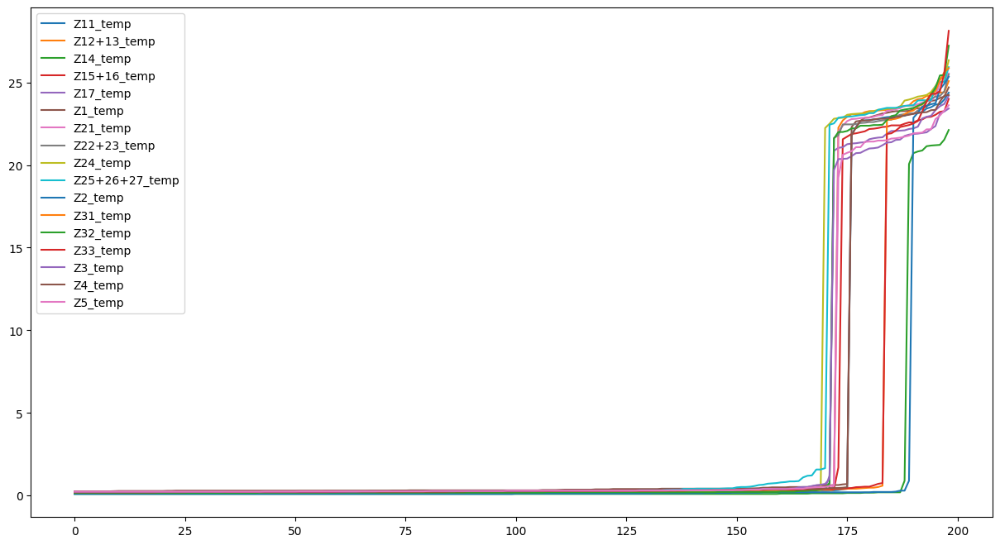

In [9]:
df.plot(figsize=(15, 8))

In [10]:
#Statistical observation
df.mean().mean()

2.8282293671515824

In [11]:
#Observe the .9 quantile (where 90% of the differences lie in)
df.quantile(0.9)

Z11_temp          22.668000
Z12+13_temp       23.104000
Z14_temp           0.164000
Z15+16_temp       21.992000
Z17_temp          21.364000
Z1_temp           22.716000
Z21_temp          22.844000
Z22+23_temp       22.544001
Z24_temp          23.120001
Z25+26+27_temp    23.024001
Z2_temp            0.200001
Z31_temp           0.443999
Z32_temp          22.379999
Z33_temp           0.523999
Z3_temp           20.768000
Z4_temp           22.668000
Z5_temp           21.144000
Name: 0.9, dtype: float64

In [12]:
#Observe the statistical summary of the data
df.describe()

,Z11_temp,Z12+13_temp,Z14_temp,Z15+16_temp,Z17_temp,Z1_temp,Z21_temp,Z22+23_temp,Z24_temp,Z25+26+27_temp,Z2_temp,Z31_temp,Z32_temp,Z33_temp,Z3_temp,Z4_temp,Z5_temp
count,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000,199.000000
mean,2.855352,3.258141,1.166432,3.006533,3.194397,3.011960,3.291809,3.295729,3.629296,3.599598,1.210352,2.035678,3.317889,2.028342,3.163467,2.927739,3.087186
std,7.326575,7.895498,4.595787,7.403308,7.514257,7.363529,7.834036,7.855199,8.301603,8.106984,4.961248,6.241754,7.918832,6.153862,7.275104,7.286296,7.230722
min,0.180000,0.180000,0.100000,0.160000,0.180000,0.260000,0.219999,0.179998,0.180000,0.200001,0.100000,0.180000,0.160000,0.200001,0.219999,0.240000,0.240000
25%,0.199999,0.195000,0.100000,0.180000,0.199999,0.299999,0.220001,0.180000,0.199999,0.219999,0.100000,0.200001,0.179998,0.220001,0.240000,0.260000,0.250000
50%,0.200001,0.200001,0.100000,0.199999,0.200001,0.320000,0.260000,0.190001,0.200001,0.250000,0.100000,0.240000,0.180000,0.260000,0.280001,0.299999,0.299999
75%,0.250000,0.220000,0.100000,0.220001,0.290001,0.420000,0.305000,0.200001,0.240000,0.440000,0.169999,0.320000,0.219999,0.340000,0.345000,0.349999,0.330000
max,24.379999,25.080000,22.120001,24.000000,24.200001,24.700001,25.540001,25.480000,26.340000,25.920000,25.340000,25.860001,27.219999,28.120001,23.420000,24.240000,23.620001


In [13]:
#Assign quantile to variable
q_values = df.quantile(0.9)

In [14]:
q_values

Z11_temp          22.668000
Z12+13_temp       23.104000
Z14_temp           0.164000
Z15+16_temp       21.992000
Z17_temp          21.364000
Z1_temp           22.716000
Z21_temp          22.844000
Z22+23_temp       22.544001
Z24_temp          23.120001
Z25+26+27_temp    23.024001
Z2_temp            0.200001
Z31_temp           0.443999
Z32_temp          22.379999
Z33_temp           0.523999
Z3_temp           20.768000
Z4_temp           22.668000
Z5_temp           21.144000
Name: 0.9, dtype: float64

In [15]:
q_values.mean()

17.15694117826576

In [16]:
Zone_Temp.columns.values

array(['Z11_temp', 'Z12+13_temp', 'Z14_temp', 'Z15+16_temp', 'Z17_temp',
       'Z1_temp', 'Z21_temp', 'Z22+23_temp', 'Z24_temp', 'Z25+26+27_temp',
       'Z2_temp', 'Z31_temp', 'Z32_temp', 'Z33_temp', 'Z3_temp',
       'Z4_temp', 'Z5_temp'], dtype=object)

In [17]:
# Update 'Lst_name' to contain the names of columns
Lst_name = Zone_Temp.columns.values

In [18]:
#If the absolute difference between consecutive values is greater than 1.5, drop them.
#IMPORTANT: Observe statistical summary to determine the abs diff condition.
for i in range(0,len(Lst_name)):
    df = Zone_Temp[Lst_name[i]]
#     print (df.diff(), q_values[i])
    print (df[abs(df.diff())> 1.5].index)
    Zone_Temp[Lst_name[i]] = df.drop(df[abs(df.diff())> 1.5].index)

DatetimeIndex(['2023-06-27 13:49:00-04:00', '2023-06-27 13:50:00-04:00',
               '2023-07-14 13:30:00-04:00', '2023-07-14 13:31:00-04:00',
               '2023-08-14 09:33:00-04:00', '2023-08-14 09:35:00-04:00',
               '2023-08-21 15:47:00-04:00', '2023-08-21 15:50:00-04:00',
               '2023-09-06 17:39:00-04:00', '2023-09-07 09:07:00-04:00',
               '2023-09-26 10:18:00-04:00', '2023-09-26 10:21:00-04:00',
               '2023-10-12 10:57:00-04:00', '2023-10-12 10:59:00-04:00',
               '2023-11-08 10:01:00-05:00', '2023-11-08 10:04:00-05:00',
               '2023-11-21 11:43:00-05:00', '2023-11-21 11:45:00-05:00',
               '2023-11-29 03:46:00-05:00', '2023-11-29 03:47:00-05:00',
               '2023-11-30 13:39:00-05:00', '2023-11-30 13:41:00-05:00',
               '2024-02-15 09:40:00-05:00', '2024-02-15 09:42:00-05:00',
               '2024-02-26 11:49:00-05:00', '2024-02-26 11:50:00-05:00',
               '2024-02-26 18:55:00-05:00', '2024-0

<Axes: xlabel='Timestamp'>

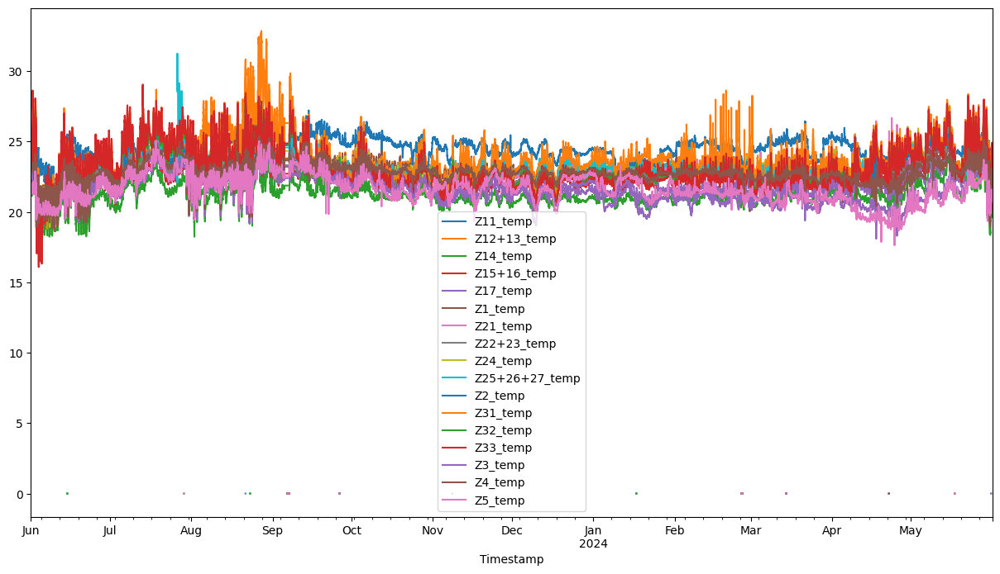

In [19]:
Zone_Temp.plot(figsize=(15, 8))

In [20]:
#Define outlier removal: Mahalanobis distance method
def mahalanobis_distance(x, data):
    """Calculate the Mahalanobis distance for each observation in x from the distribution of data"""
    x_minus_mu = x - np.mean(data)
    cov = np.cov(data.values.T)
    inv_covmat = np.linalg.inv(cov)
    left_term = np.dot(x_minus_mu, inv_covmat)
    mahal = np.dot(left_term, x_minus_mu.T)
    return mahal.diagonal()

def remove_outliers(df, columns):
    # Assuming df has a datetime index, group by year and month
    groups = df.groupby([df.index.year, df.index.month])
    
    # Process each group
    for (year, month), group in groups:
        feature_set = group[columns]
        
        # Skip groups with less data points than columns to avoid singular matrix error
        if feature_set.shape[0] <= feature_set.shape[1]:
            continue
        
        # Compute the Mahalanobis distance for each observation
        group['mahalanobis'] = mahalanobis_distance(x=feature_set, data=feature_set)
        # Calculate the p-value for each Mahalanobis distance
        group['p_value'] = 1 - chi2.cdf(group['mahalanobis'], df=feature_set.shape[1])
        
        # Choose a significance level
        significance_level = 0.005
        # Identify outliers
        outliers = group['p_value'] < significance_level
        # Set outliers to NaN
        df.loc[group[outliers].index, columns] = np.nan
    
    # Drop columns for Mahalanobis distance and p-value if they exist
    df.drop(columns=['mahalanobis', 'p_value'], errors='ignore', inplace=True)
    
    return df

# Define subsets for each zone
Zone_Temp_base = ['Z1_temp', 'Z2_temp', 'Z3_temp', 'Z4_temp', 'Z5_temp']
Zone_Temp_fir = ['Z11_temp', 'Z12+13_temp', 'Z14_temp', 'Z15+16_temp', 'Z17_temp']
Zone_Temp_sec = ['Z21_temp', 'Z22+23_temp', 'Z24_temp', 'Z25+26+27_temp']
Zone_Temp_thi = ['Z31_temp', 'Z32_temp', 'Z33_temp']


<h2>Outlier Removal</h2>
Plot by groups (year, month, and weeks if necessary.
<br>
Apply the following methods based on observed plots and statistical summary
<ul>
    <li>Mahalanobis distance</li>
    <li>Statistical Summary based condition</li>
</ul>

<Axes: xlabel='Timestamp'>

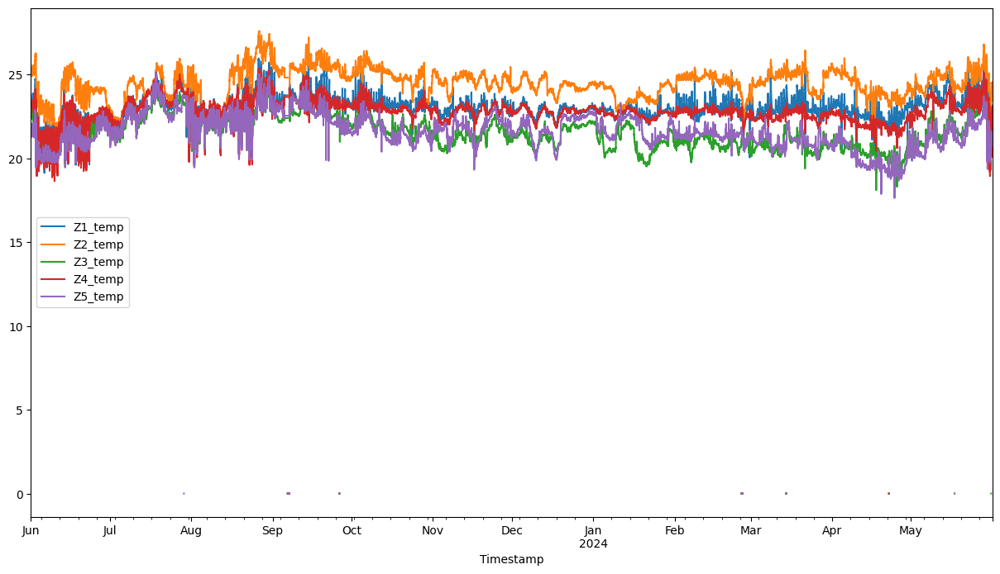

In [21]:
Zone_Temp[Zone_Temp_base].plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

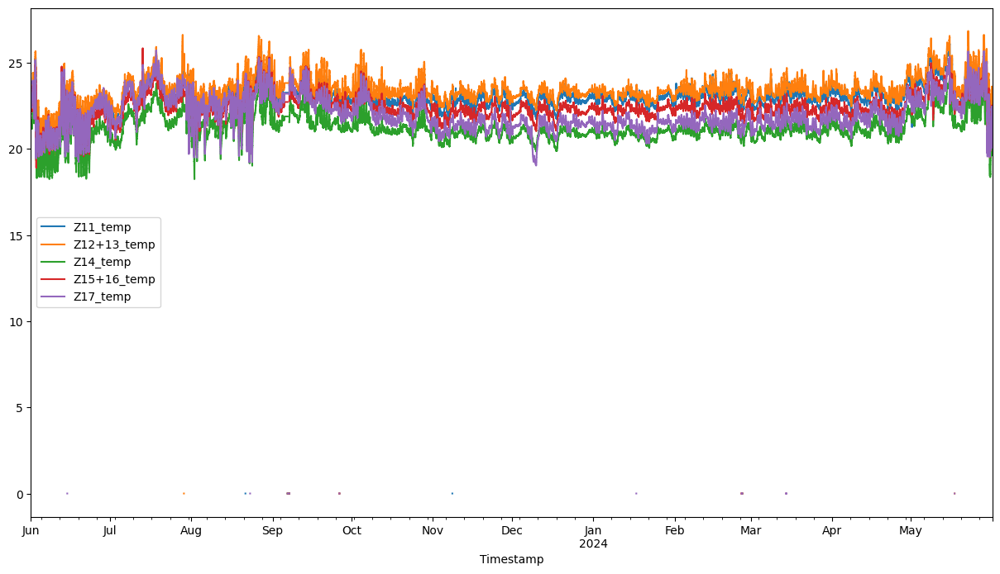

In [22]:
Zone_Temp[Zone_Temp_fir].plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

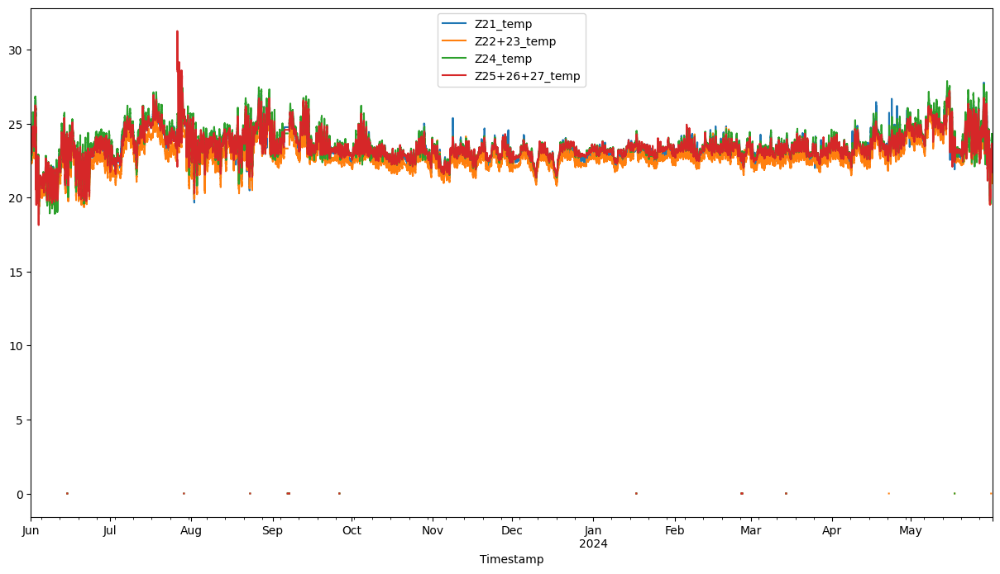

In [23]:
Zone_Temp[Zone_Temp_sec].plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

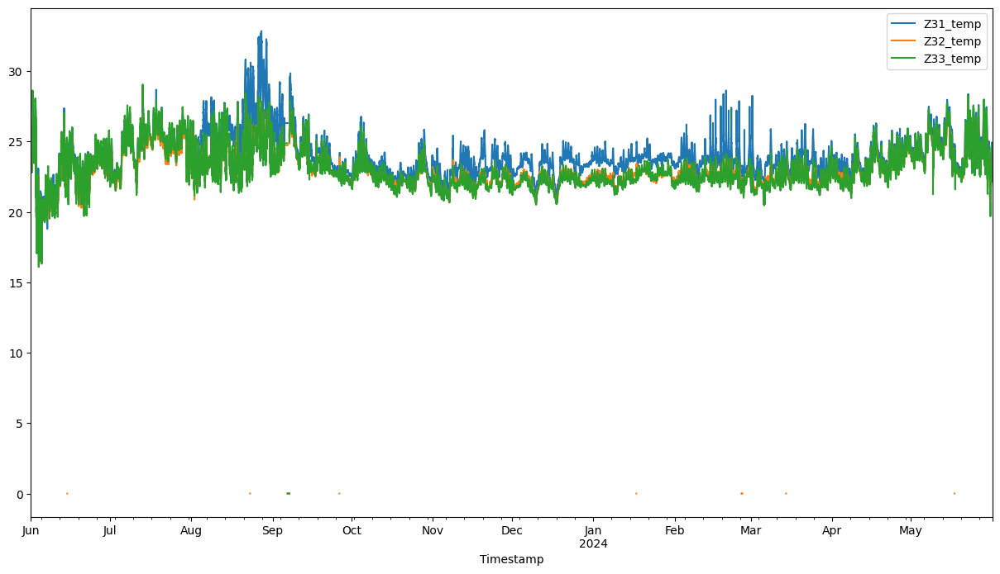

In [24]:
Zone_Temp[Zone_Temp_thi].plot(figsize=(15, 8))

In [25]:
#Check the range of timestamps (start to end)
print(Zone_Temp.index.min(), Zone_Temp.index.max())

2023-06-01 00:00:00-04:00 2024-05-31 23:59:00-04:00


In [26]:
Zone_Temp[Zone_Temp < 10] = np.nan

<Axes: xlabel='Timestamp'>

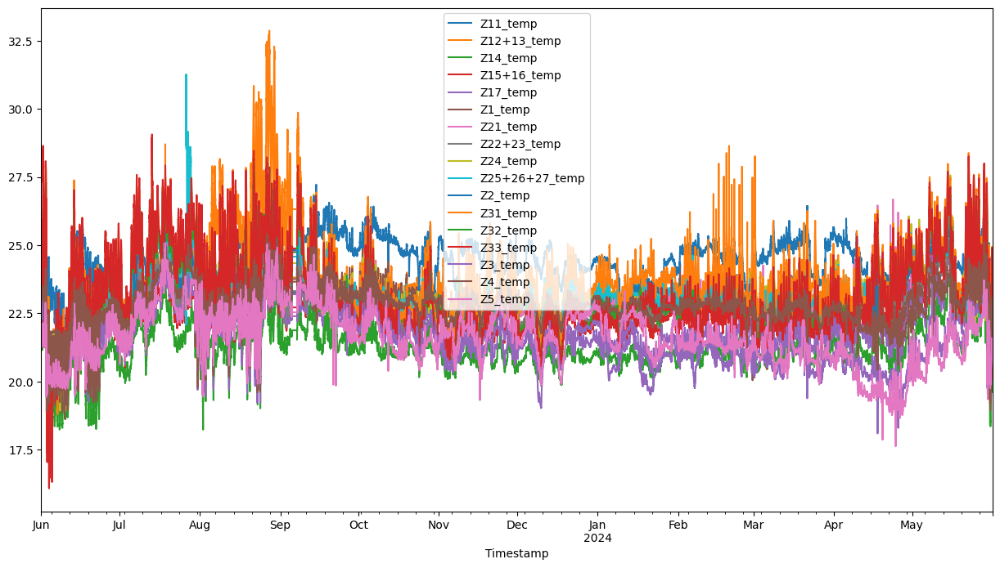

In [27]:
Zone_Temp.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

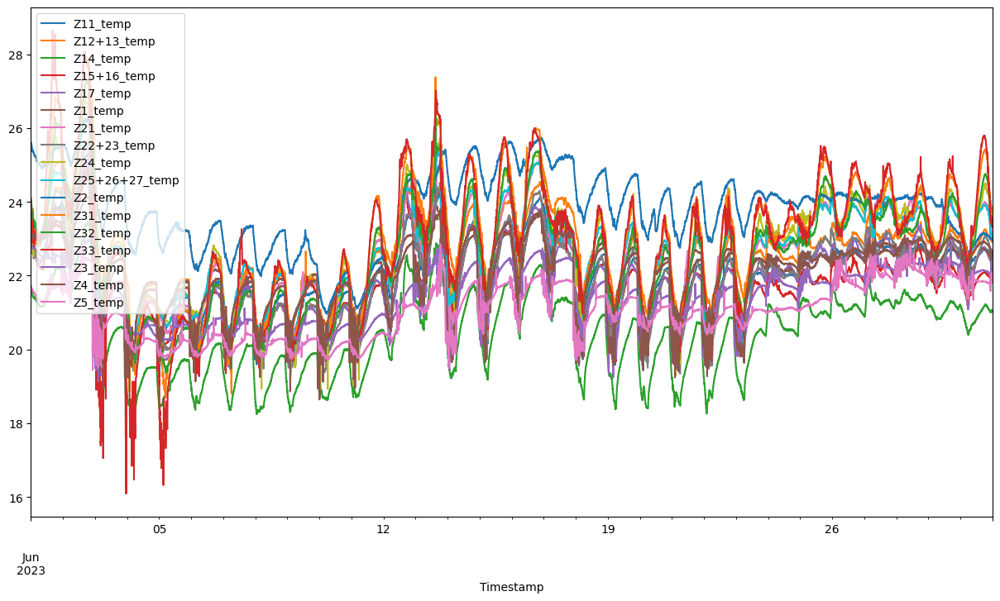

In [28]:
Zone_Temp1 = Zone_Temp["2023-06-01": "2023-06-30"]

Zone_Temp1.plot(figsize=(15, 8))

In [29]:
# #Apply Mahalanobis distance outlier removal method
# Zone_Temp1 = remove_outliers(Zone_Temp1, Zone_Temp_base)
# Zone_Temp1 = remove_outliers(Zone_Temp1, Zone_Temp_fir)
# Zone_Temp1 = remove_outliers(Zone_Temp1, Zone_Temp_sec)
# Zone_Temp1 = remove_outliers(Zone_Temp1, Zone_Temp_thi)

# Zone_Temp1.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

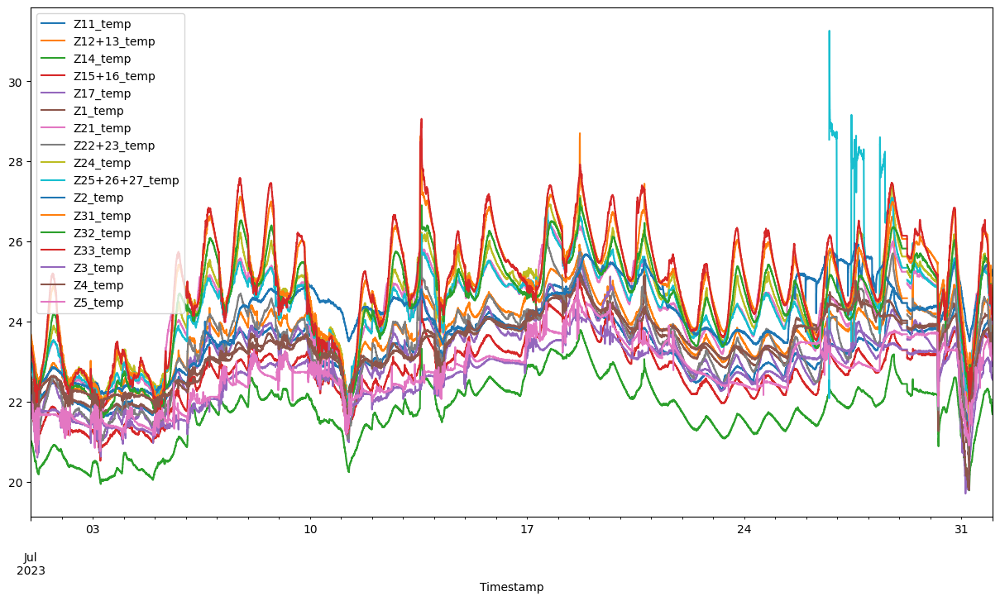

In [30]:
Zone_Temp2 = Zone_Temp["2023-07-01": "2023-07-31"]
Zone_Temp2.plot(figsize=(15, 8))

In [31]:
# #Apply Mahalanobis distance outlier removal method
# Zone_Temp2 = remove_outliers(Zone_Temp2, Zone_Temp_base)
# Zone_Temp2 = remove_outliers(Zone_Temp2, Zone_Temp_fir)
# Zone_Temp2 = remove_outliers(Zone_Temp2, Zone_Temp_sec)
# Zone_Temp2 = remove_outliers(Zone_Temp2, Zone_Temp_thi)

# Zone_Temp2.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

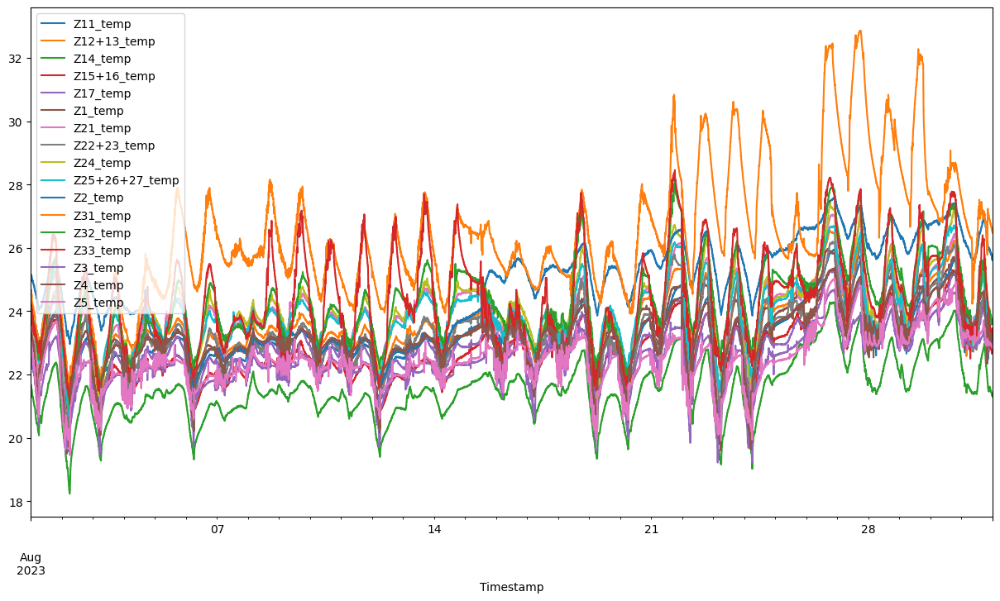

In [32]:
Zone_Temp3 = Zone_Temp["2023-08-01": "2023-08-31"]
Zone_Temp3.plot(figsize=(15, 8))

In [33]:
# #Apply Mahalanobis distance outlier removal method (based on plots)
# Zone_Temp3 = remove_outliers(Zone_Temp3, Zone_Temp_base)
# Zone_Temp3 = remove_outliers(Zone_Temp3, Zone_Temp_fir)
# Zone_Temp3 = remove_outliers(Zone_Temp3, Zone_Temp_sec)
# Zone_Temp3 = remove_outliers(Zone_Temp3, Zone_Temp_thi)

# Zone_Temp3.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

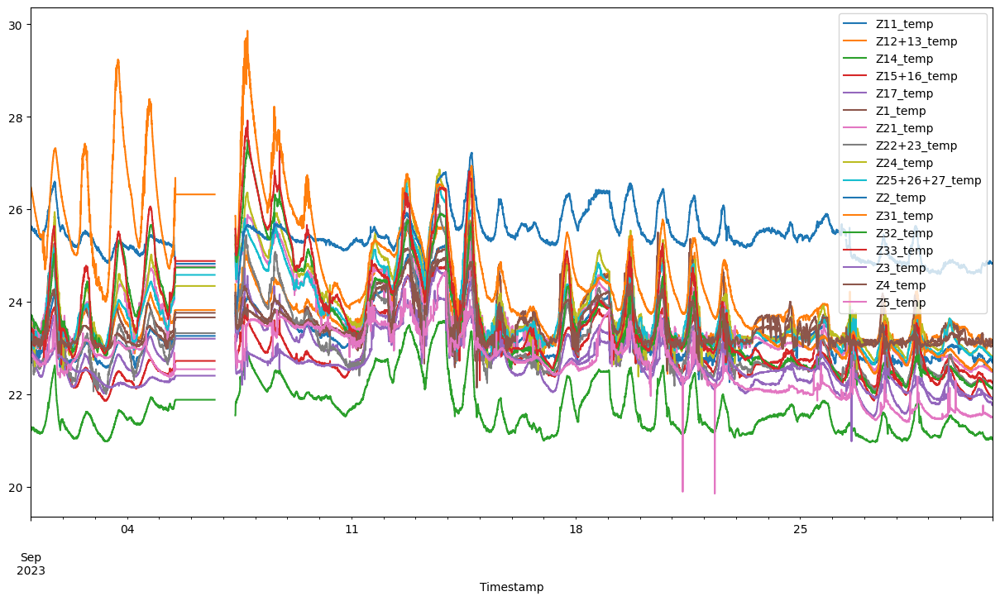

In [34]:
Zone_Temp4 = Zone_Temp["2023-09-01": "2023-09-30"]
Zone_Temp4.plot(figsize=(15, 8))

In [35]:
# Zone_Temp4 = remove_outliers(Zone_Temp4, Zone_Temp_base)
# Zone_Temp4 = remove_outliers(Zone_Temp4, Zone_Temp_fir)
# Zone_Temp4 = remove_outliers(Zone_Temp4, Zone_Temp_sec)
# Zone_Temp4 = remove_outliers(Zone_Temp4, Zone_Temp_thi)

# Zone_Temp4.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

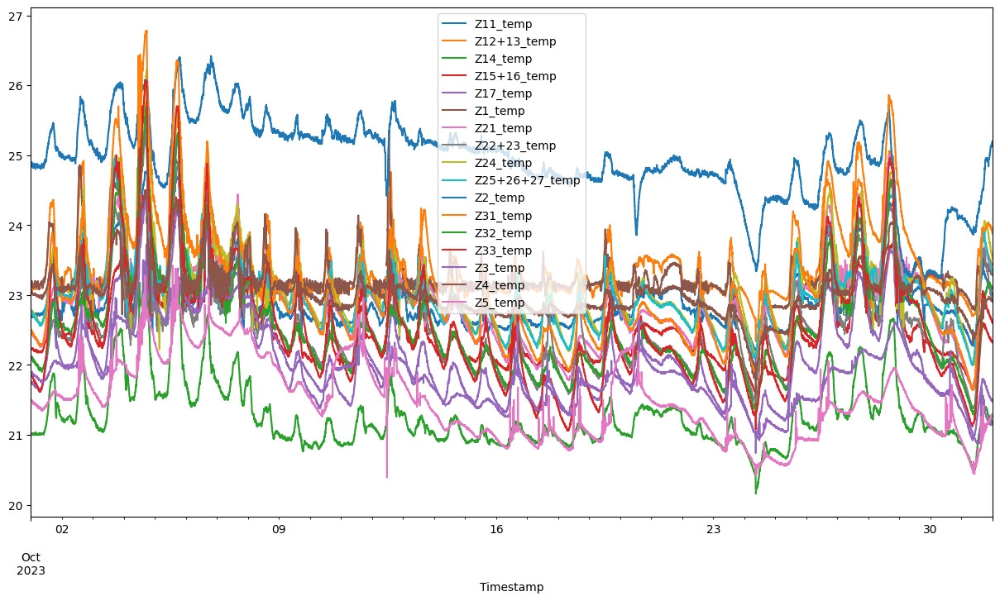

In [36]:
Zone_Temp5 = Zone_Temp["2023-10-01": "2023-10-31"]
Zone_Temp5.plot(figsize=(15, 8))

In [37]:
# Zone_Temp5 = remove_outliers(Zone_Temp5, Zone_Temp_base)
# Zone_Temp5 = remove_outliers(Zone_Temp5, Zone_Temp_fir)
# Zone_Temp5 = remove_outliers(Zone_Temp5, Zone_Temp_sec)
# Zone_Temp5 = remove_outliers(Zone_Temp5, Zone_Temp_thi)

# Zone_Temp5.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

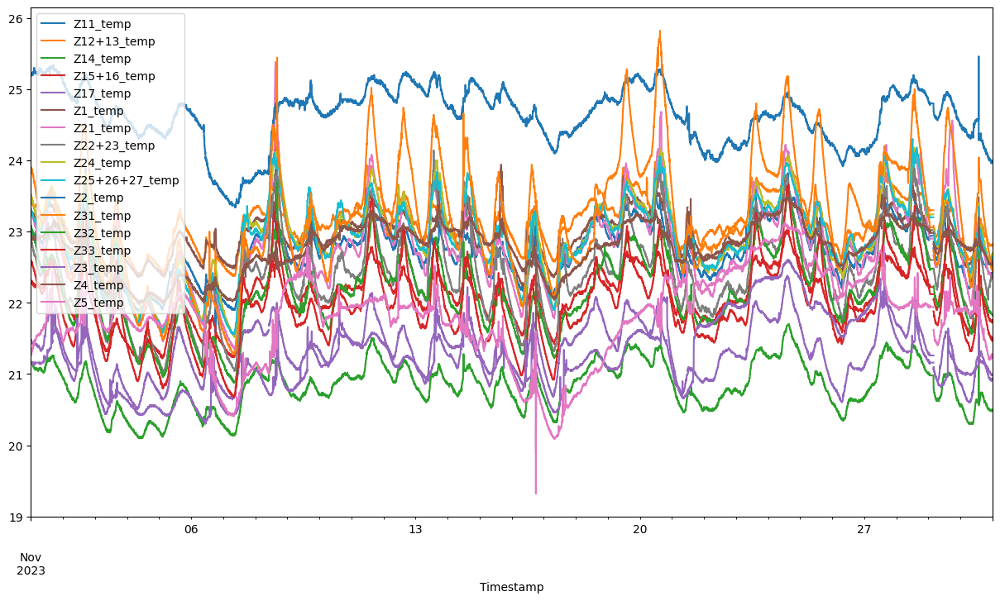

In [38]:
Zone_Temp6 = Zone_Temp["2023-11-01": "2023-11-30"]
Zone_Temp6.plot(figsize=(15, 8))

In [39]:
# Zone_Temp6 = remove_outliers(Zone_Temp6, Zone_Temp_base)
# Zone_Temp6 = remove_outliers(Zone_Temp6, Zone_Temp_fir)
# Zone_Temp6 = remove_outliers(Zone_Temp6, Zone_Temp_sec)
# Zone_Temp6 = remove_outliers(Zone_Temp6, Zone_Temp_thi)

# Zone_Temp6.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

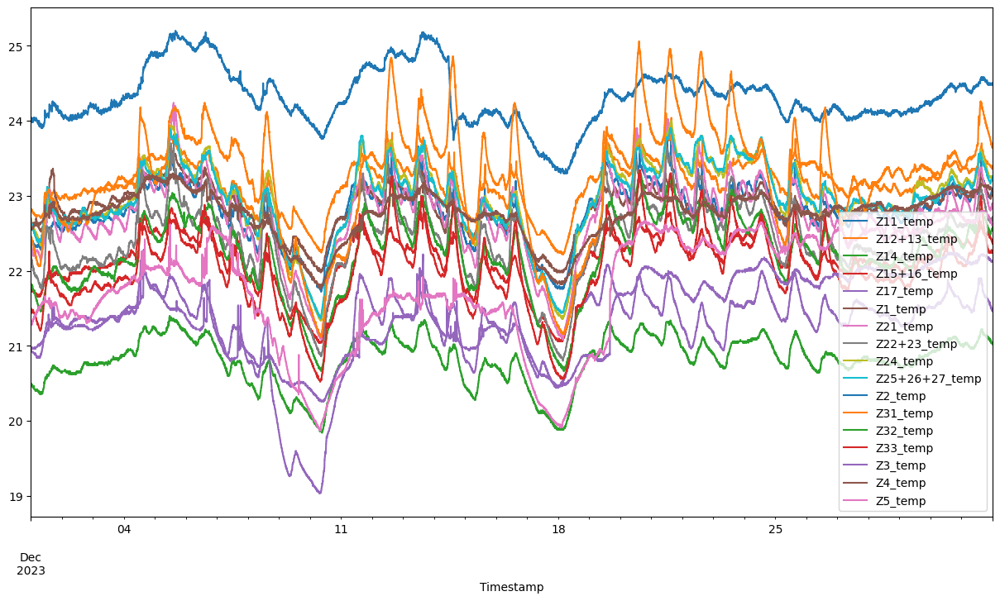

In [40]:
Zone_Temp7 = Zone_Temp["2023-12-01": "2023-12-31"]
Zone_Temp7.plot(figsize=(15, 8))

In [41]:
# Zone_Temp7 = remove_outliers(Zone_Temp7, Zone_Temp_base)
# Zone_Temp7 = remove_outliers(Zone_Temp7, Zone_Temp_fir)
# Zone_Temp7 = remove_outliers(Zone_Temp7, Zone_Temp_sec)
# Zone_Temp7 = remove_outliers(Zone_Temp7, Zone_Temp_thi)

# Zone_Temp7.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

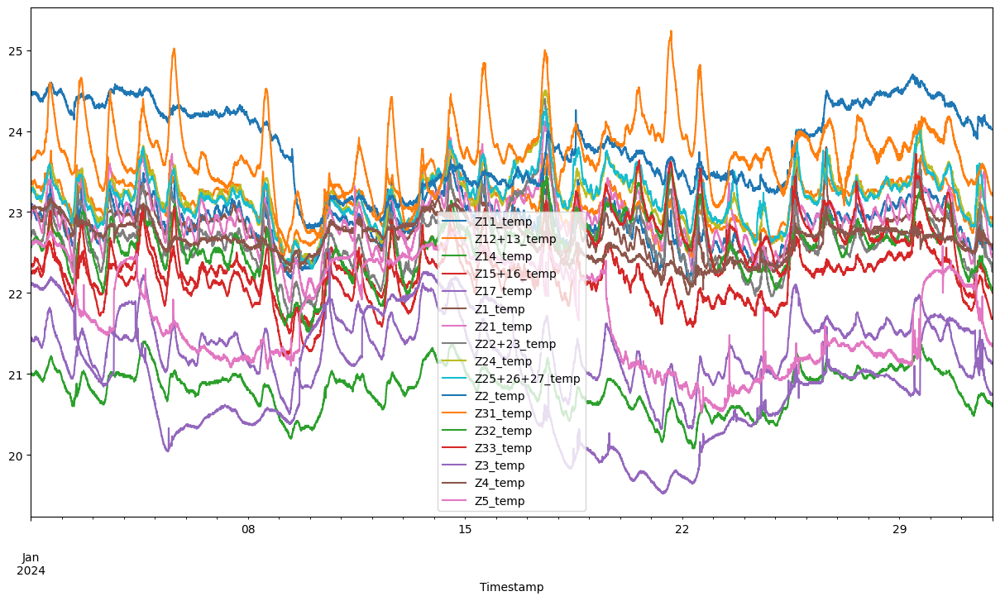

In [42]:
Zone_Temp8 = Zone_Temp["2024-01-01": "2024-01-31"]
Zone_Temp8.plot(figsize=(15, 8))

In [43]:
# # Do not apply this method 
# Zone_Temp8 = remove_outliers(Zone_Temp8, Zone_Temp_base)
# Zone_Temp8 = remove_outliers(Zone_Temp8, Zone_Temp_fir)
# Zone_Temp8 = remove_outliers(Zone_Temp8, Zone_Temp_sec)
# Zone_Temp8 = remove_outliers(Zone_Temp8, Zone_Temp_thi)

# Zone_Temp8.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

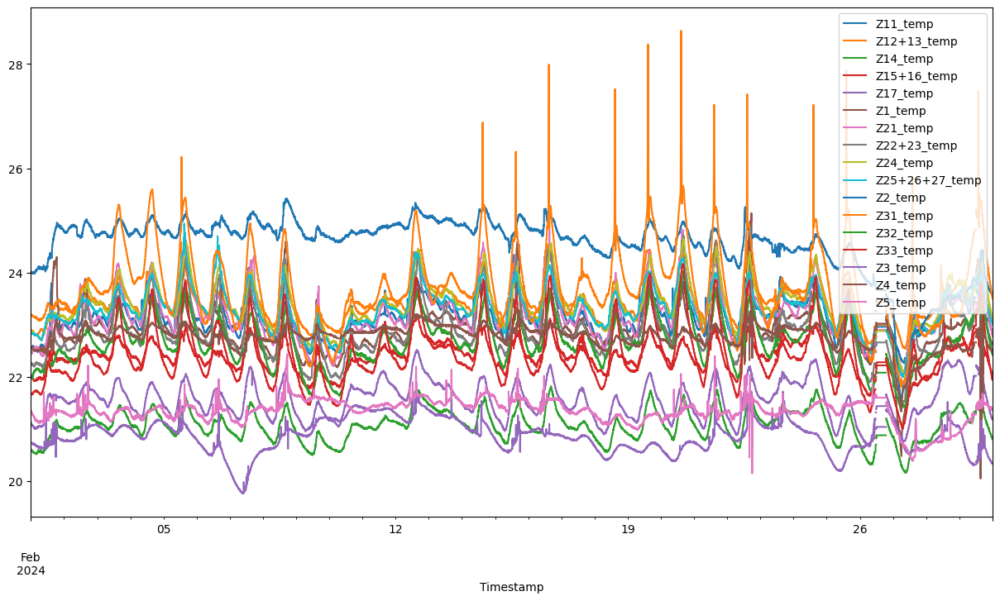

In [44]:
Zone_Temp9 = Zone_Temp["2024-02-01": "2024-02-29"]
Zone_Temp9.plot(figsize=(15, 8))

In [45]:
# # Do not apply this method 
# Zone_Temp9 = remove_outliers(Zone_Temp9, Zone_Temp_base)
# Zone_Temp9 = remove_outliers(Zone_Temp9, Zone_Temp_fir)
# Zone_Temp9 = remove_outliers(Zone_Temp9, Zone_Temp_sec)
# Zone_Temp9 = remove_outliers(Zone_Temp9, Zone_Temp_thi)

# Zone_Temp9.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

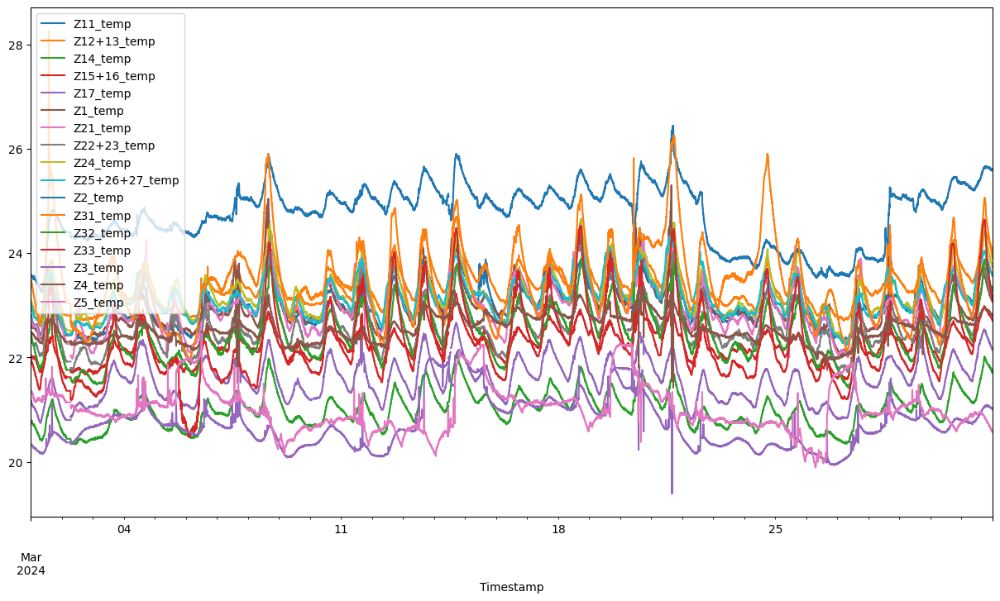

In [46]:
Zone_Temp10 = Zone_Temp["2024-03-01": "2024-03-31"]
Zone_Temp10.plot(figsize=(15, 8))

In [47]:
# # Do not apply this method 
# Zone_Temp10 = remove_outliers(Zone_Temp10, Zone_Temp_base)
# Zone_Temp10 = remove_outliers(Zone_Temp10, Zone_Temp_fir)
# Zone_Temp10 = remove_outliers(Zone_Temp10, Zone_Temp_sec)
# Zone_Temp10 = remove_outliers(Zone_Temp10, Zone_Temp_thi)

# Zone_Temp10.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

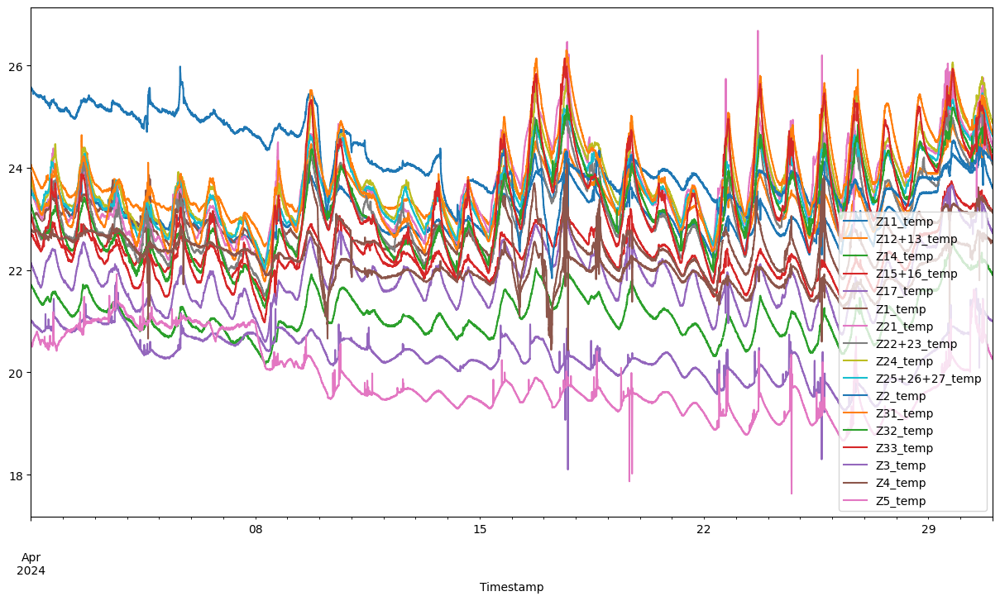

In [48]:
Zone_Temp11 = Zone_Temp["2024-04-01": "2024-04-30"]
Zone_Temp11.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

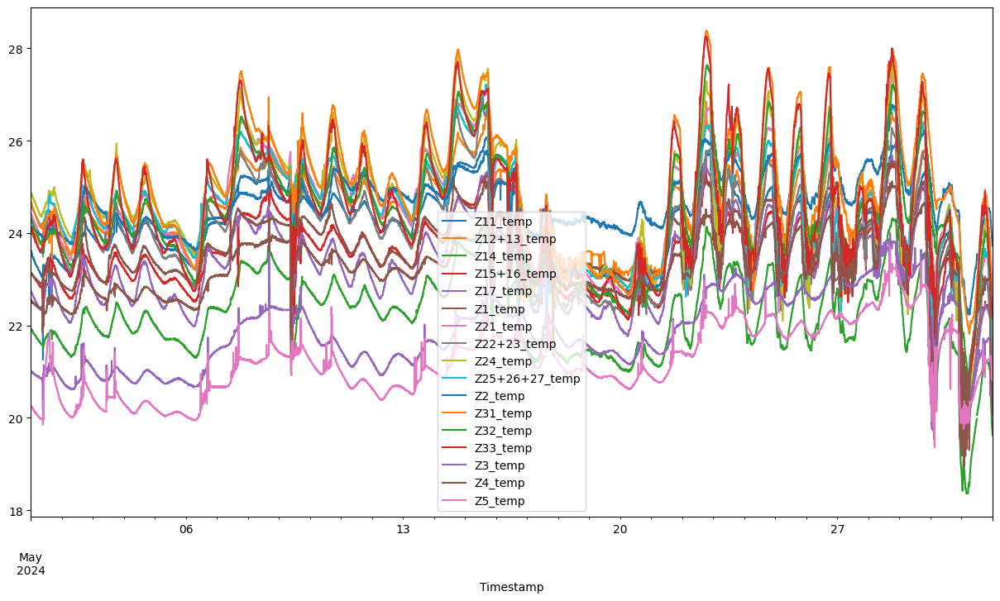

In [49]:
Zone_Temp12 = Zone_Temp["2024-05-01": "2024-05-31"]
Zone_Temp12.plot(figsize=(15, 8))

In [50]:
# Combine all dataframes
combined_df = pd.concat([Zone_Temp1, Zone_Temp2, Zone_Temp3, Zone_Temp4, Zone_Temp5, Zone_Temp6, Zone_Temp7, Zone_Temp8, Zone_Temp9, Zone_Temp10, Zone_Temp11, Zone_Temp12])

<Axes: xlabel='Timestamp'>

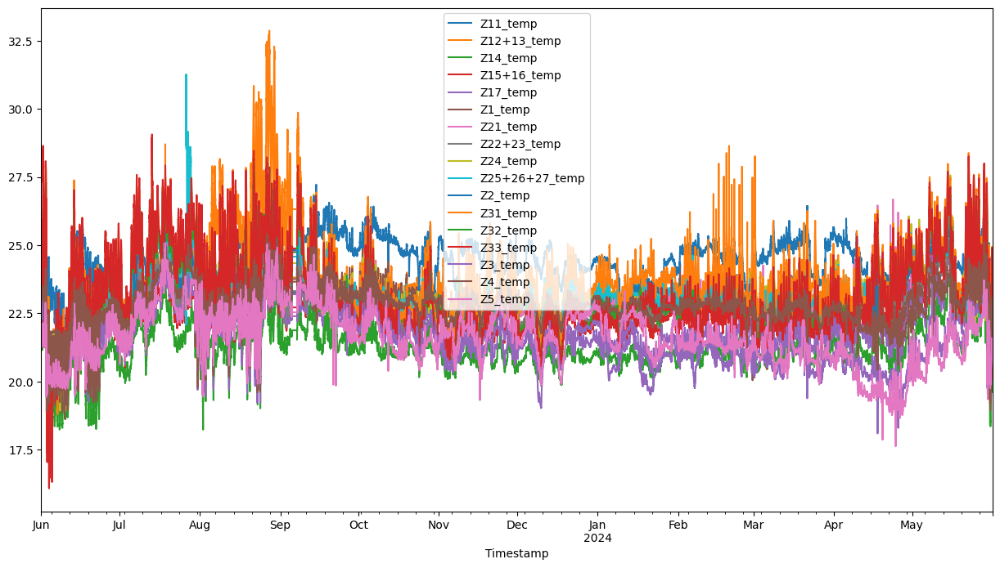

In [51]:
combined_df.plot(figsize=(15, 8))

C:\Users\Sang\AppData\Local\Temp\ipykernel_34868\1209814972.py:2: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  combined_df = combined_df.resample("H").mean().ffill()


<Axes: xlabel='Timestamp'>

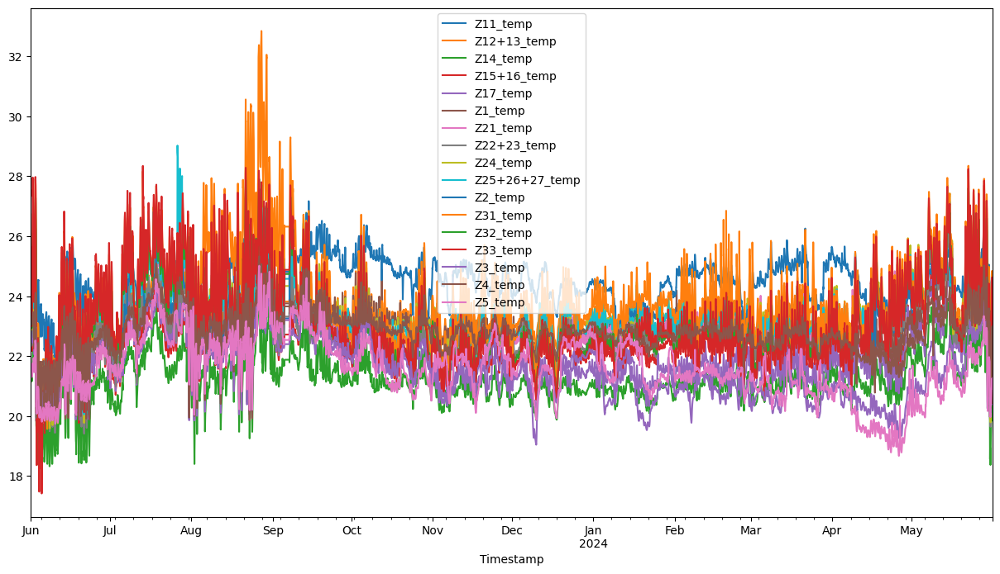

In [52]:
#Process to Hourly and forward fill (average to hour and forward fill to assign last existing value to a missing value)
combined_df = combined_df.resample("H").mean().ffill()

combined_df.plot(figsize=(15, 8))

c:\Users\Sang\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\plotting\_matplotlib\core.py:580: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


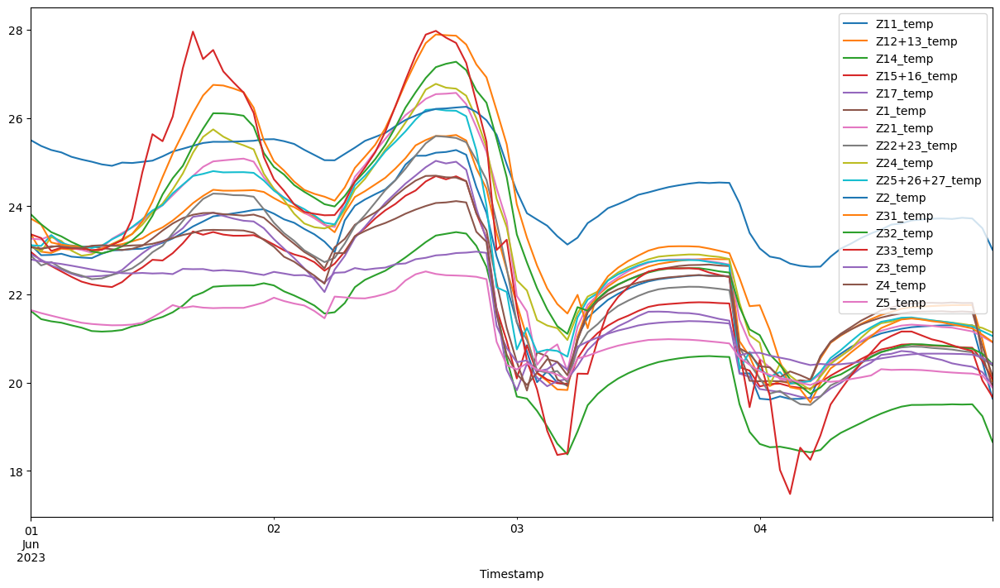

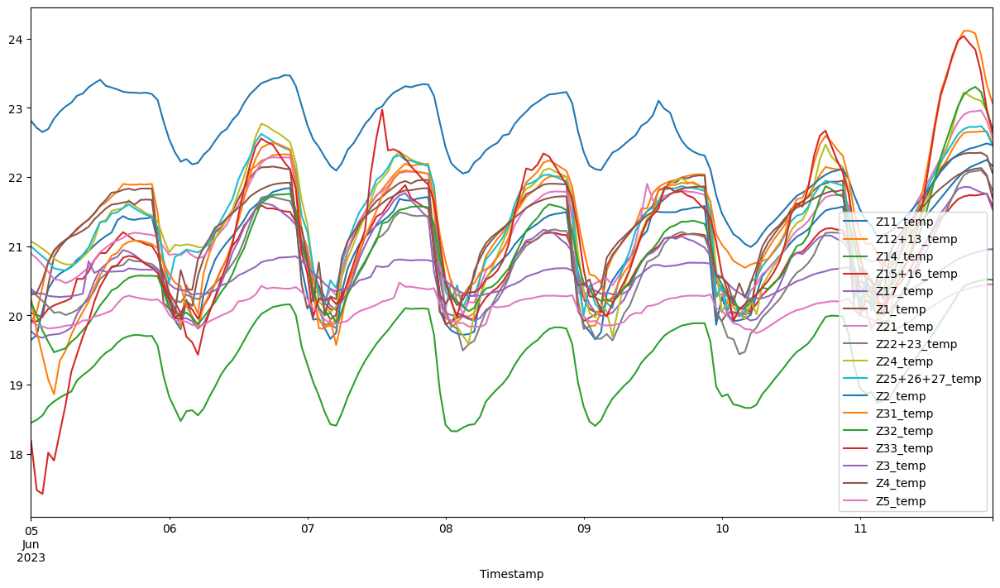

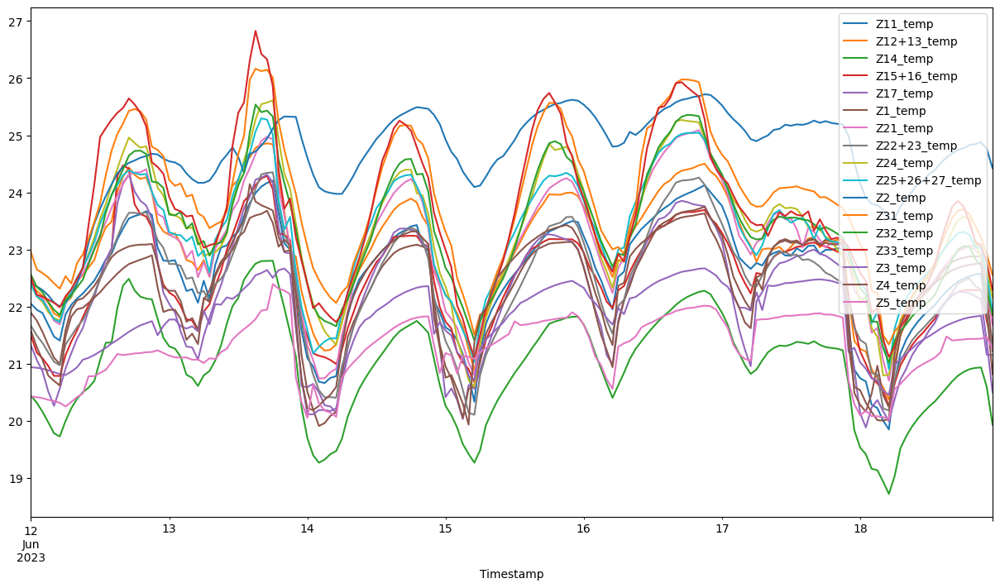

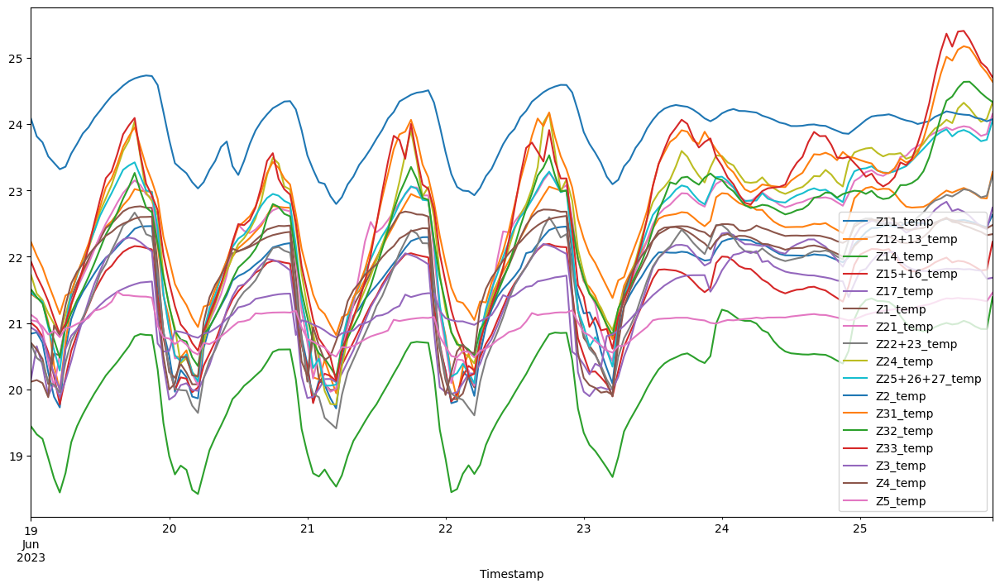

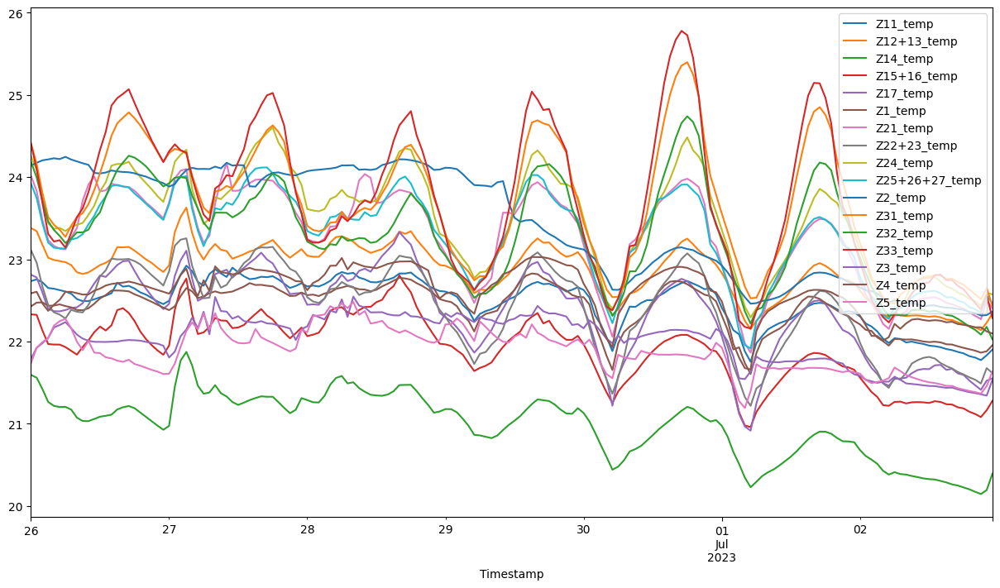

...

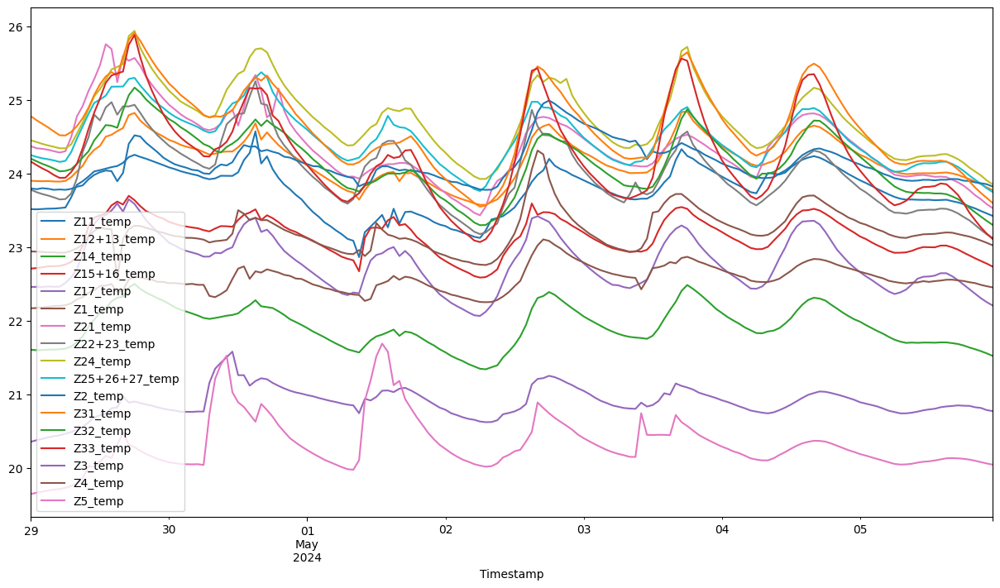

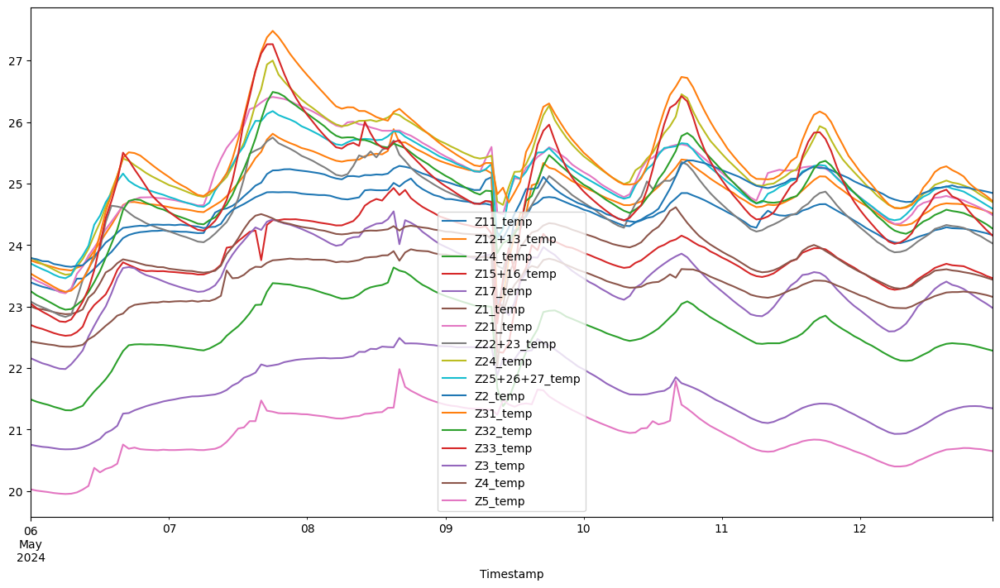

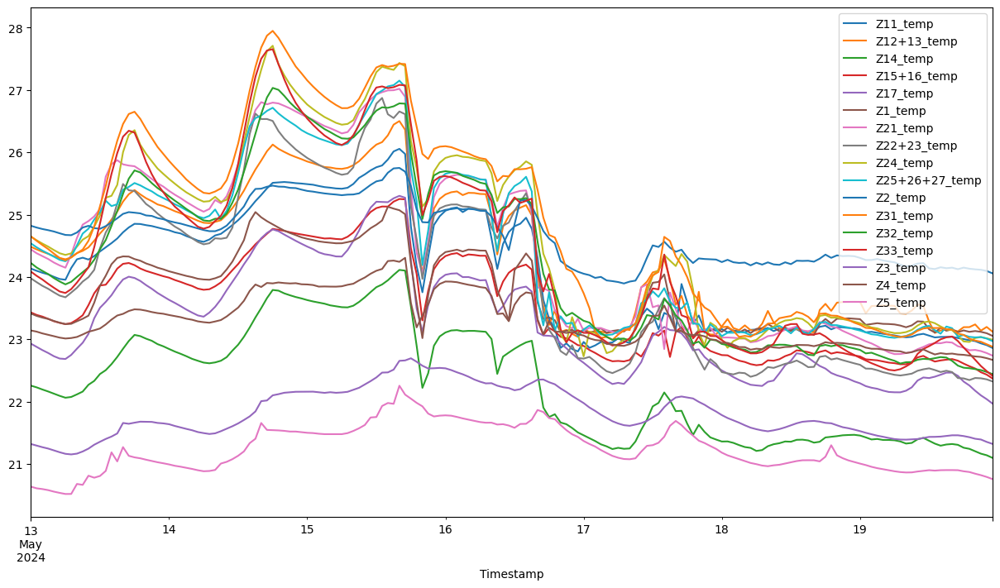

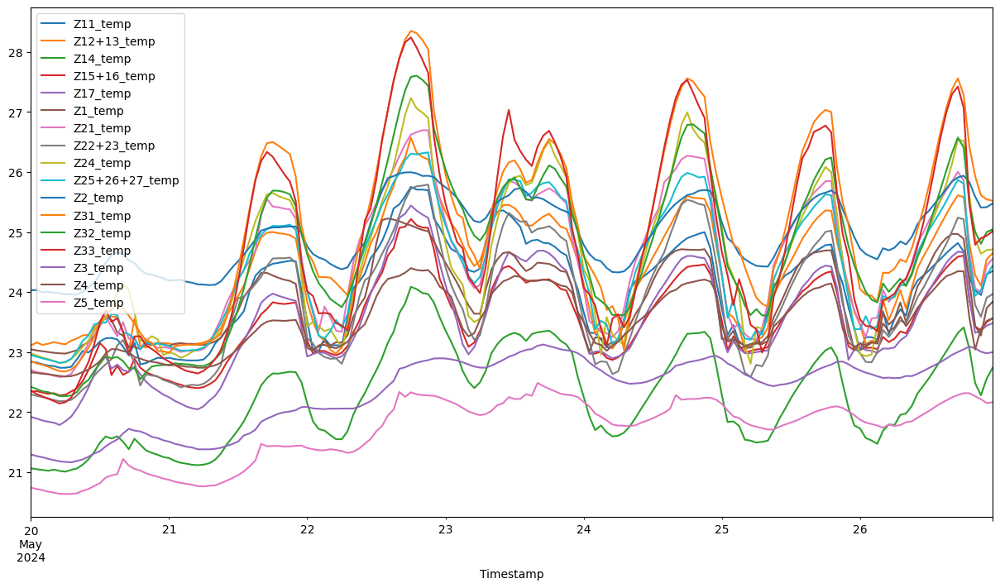

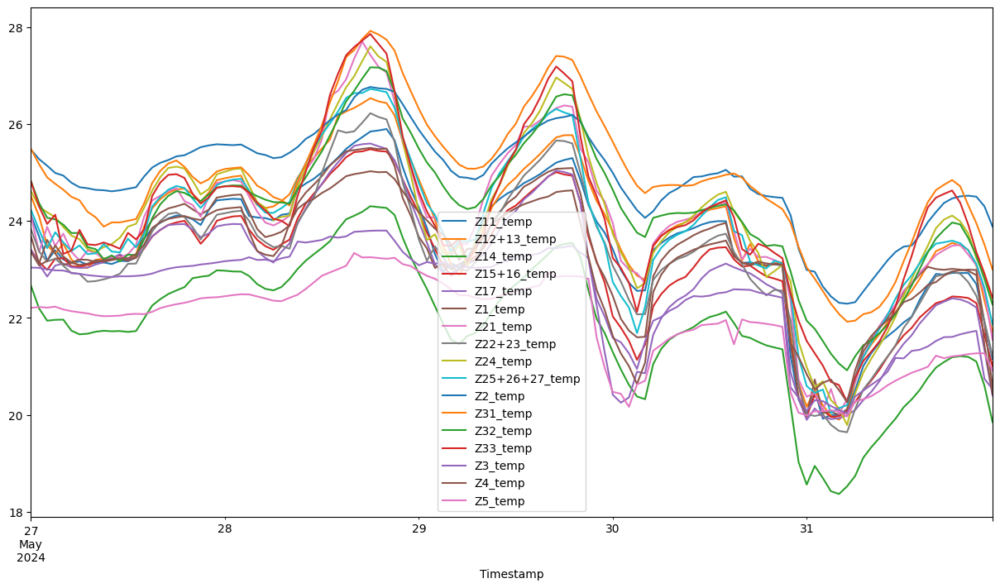

In [53]:
for (year, week), group in combined_df.groupby([combined_df.index.isocalendar().year, combined_df.index.isocalendar().week]):

    group.plot(figsize=(15, 8))
    
# combined_df.plot(figsize=(15, 8))

In [54]:
combined_df.isna().sum()

Z11_temp          0
Z12+13_temp       0
Z14_temp          0
Z15+16_temp       0
Z17_temp          0
Z1_temp           0
Z21_temp          0
Z22+23_temp       0
Z24_temp          0
Z25+26+27_temp    0
Z2_temp           0
Z31_temp          0
Z32_temp          0
Z33_temp          0
Z3_temp           0
Z4_temp           0
Z5_temp           0
dtype: int64

In [55]:
# Detecting rows with repeated values
repeated_index = (combined_df.diff() == 0).all(axis=1)
repeated_rows = combined_df[repeated_index]

# Now let's get the index of the repeated rows
repeated_rows_index = repeated_rows.index.tolist()

combined_df[repeated_index] = np.nan

In [56]:
combined_df.isna().sum()

Z11_temp          49
Z12+13_temp       49
Z14_temp          49
Z15+16_temp       49
Z17_temp          49
Z1_temp           49
Z21_temp          49
Z22+23_temp       49
Z24_temp          49
Z25+26+27_temp    49
Z2_temp           49
Z31_temp          49
Z32_temp          49
Z33_temp          49
Z3_temp           49
Z4_temp           49
Z5_temp           49
dtype: int64

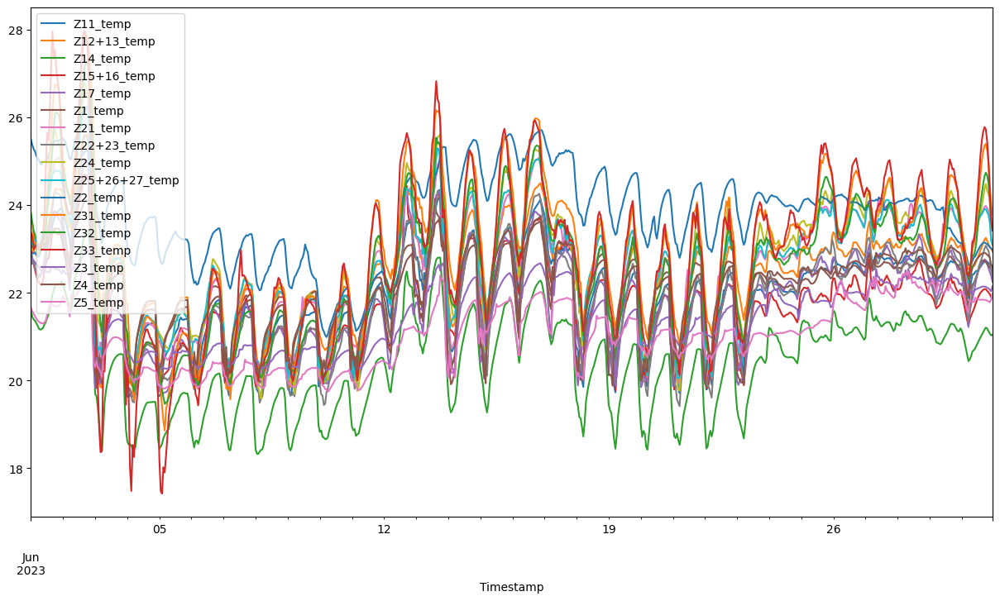

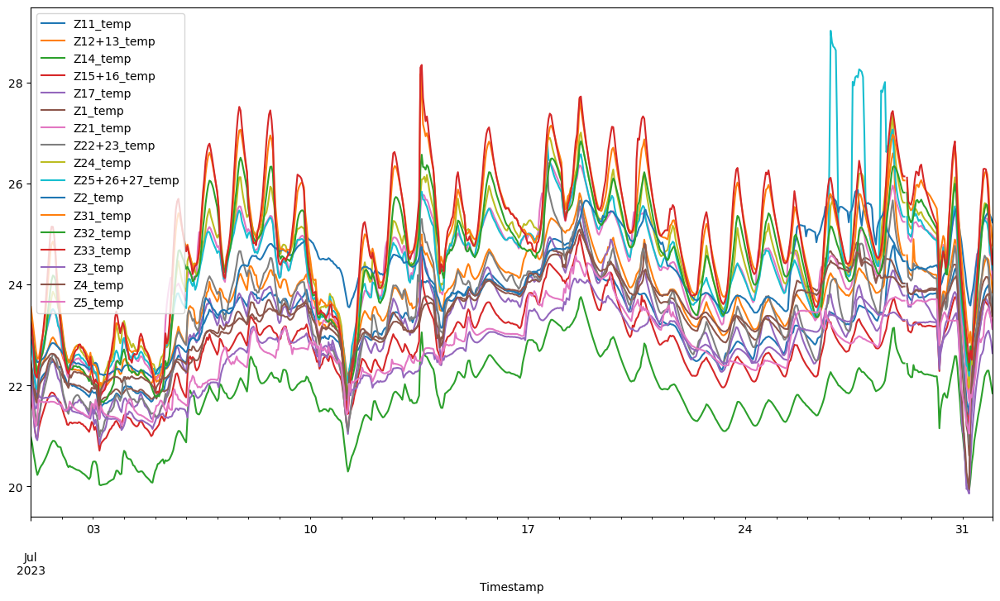

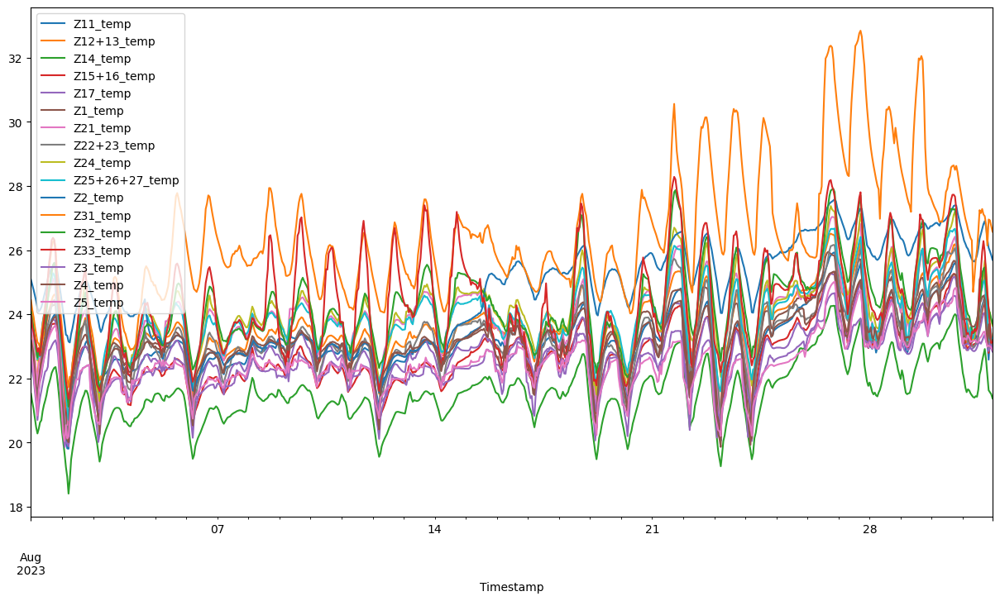

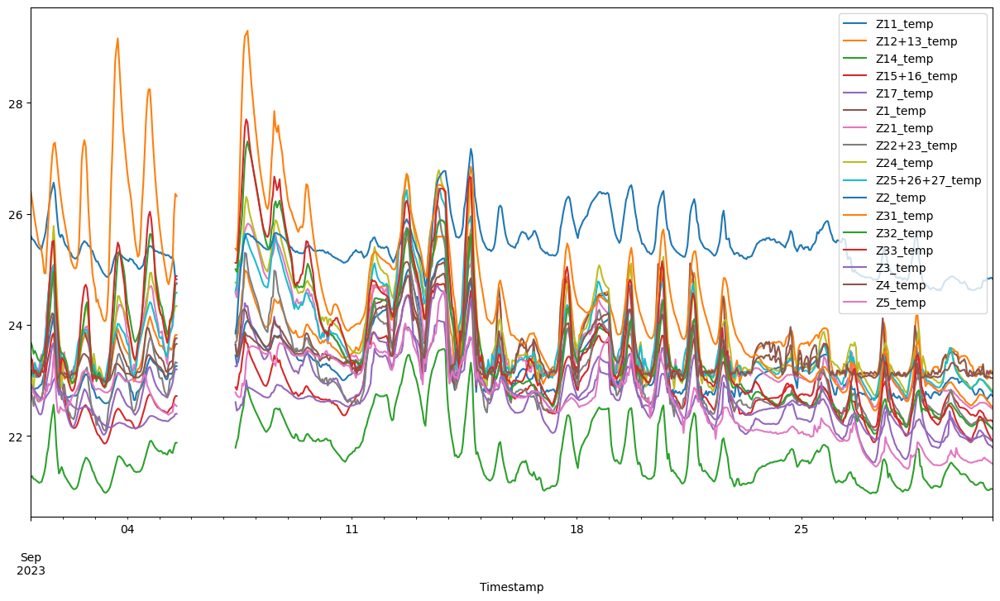

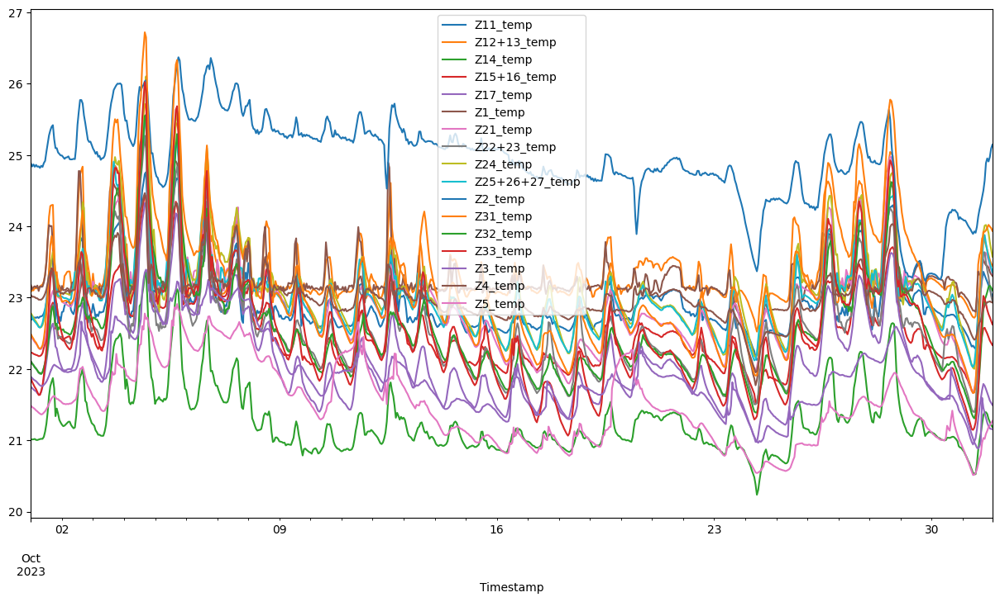

...

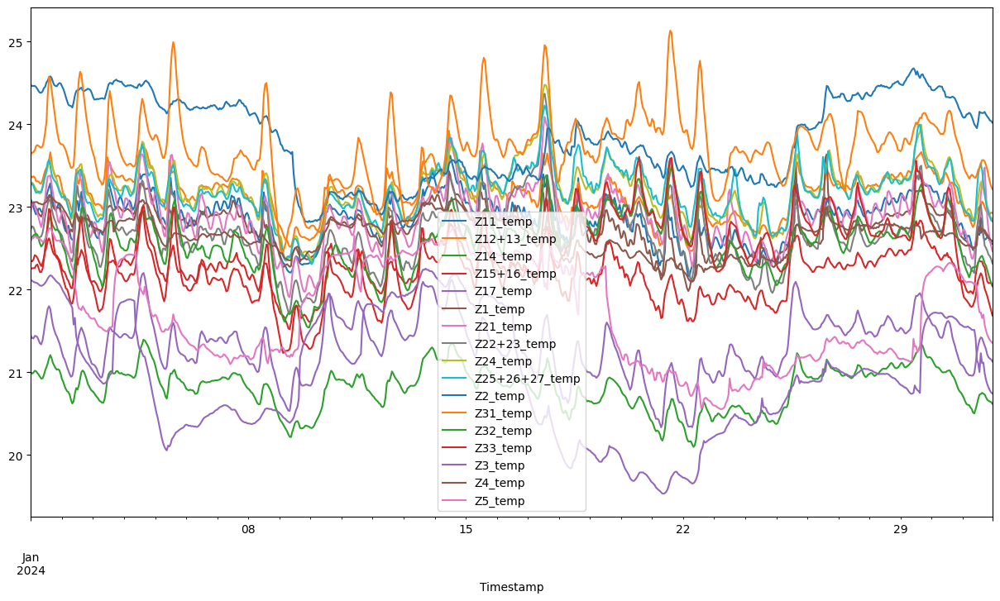

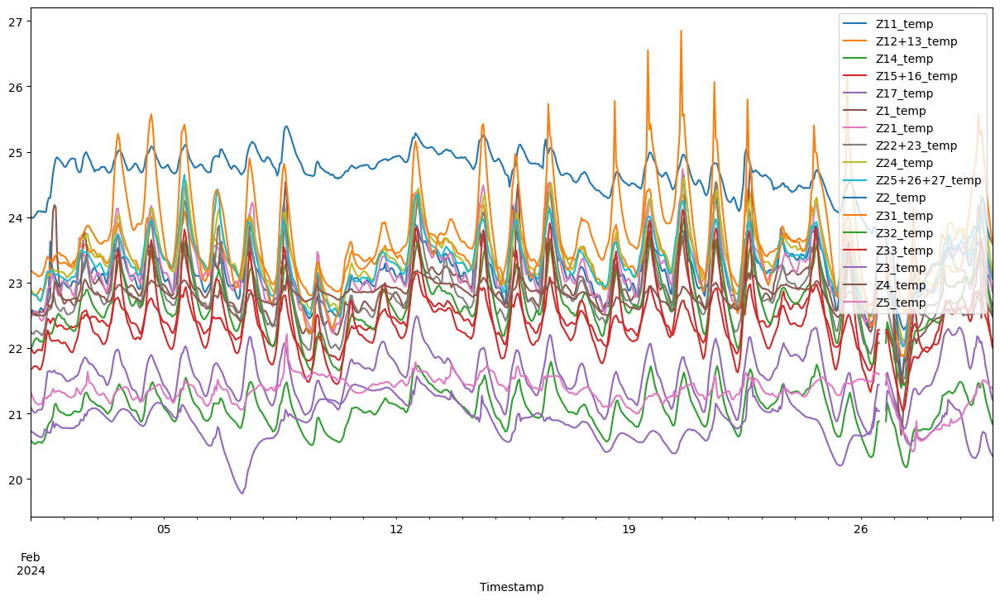

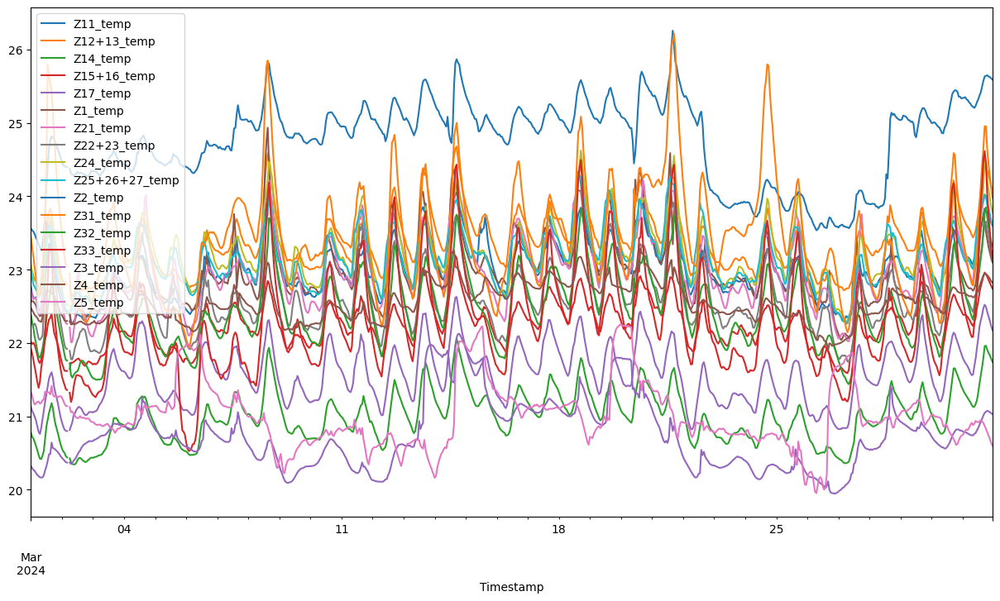

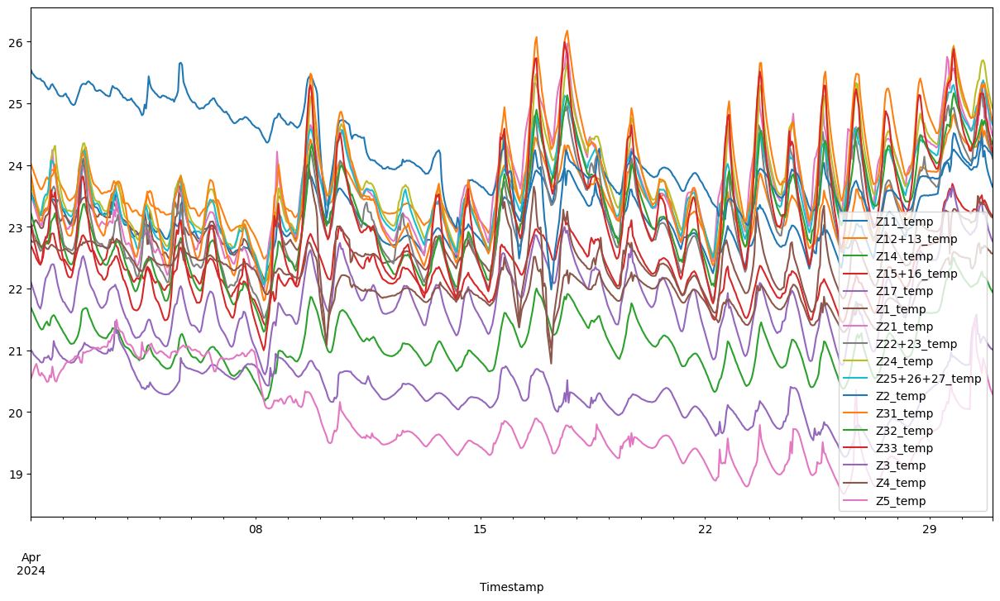

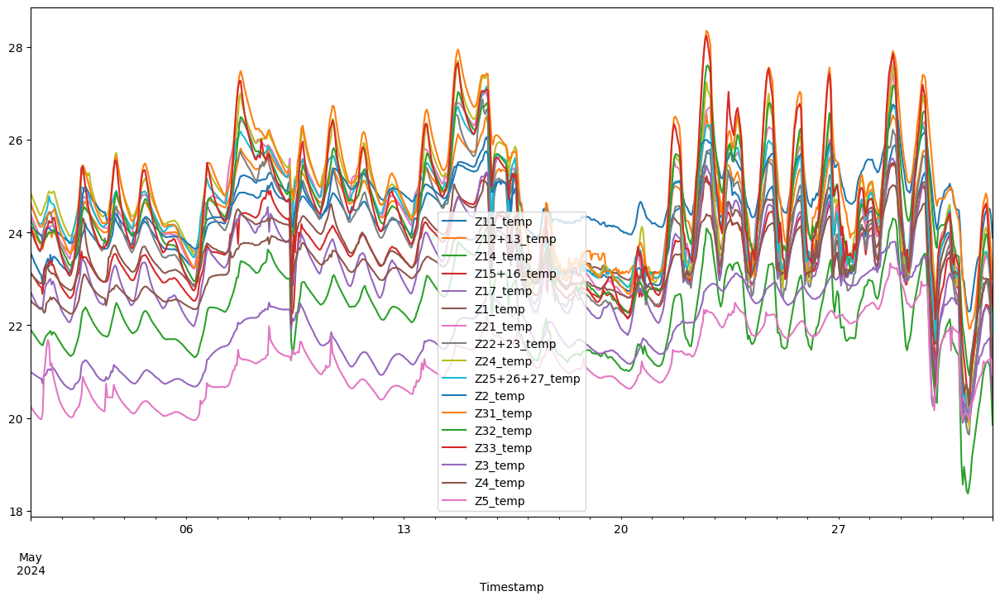

In [57]:
# Then, group by year and week number and apply Mahalanobis distance function
for (year, month), group in combined_df.groupby([combined_df.index.year, combined_df.index.month]):

    group.plot(figsize=(15, 8))

In [58]:
combined_df.isna().sum()

Z11_temp          49
Z12+13_temp       49
Z14_temp          49
Z15+16_temp       49
Z17_temp          49
Z1_temp           49
Z21_temp          49
Z22+23_temp       49
Z24_temp          49
Z25+26+27_temp    49
Z2_temp           49
Z31_temp          49
Z32_temp          49
Z33_temp          49
Z3_temp           49
Z4_temp           49
Z5_temp           49
dtype: int64

<Axes: xlabel='Timestamp'>

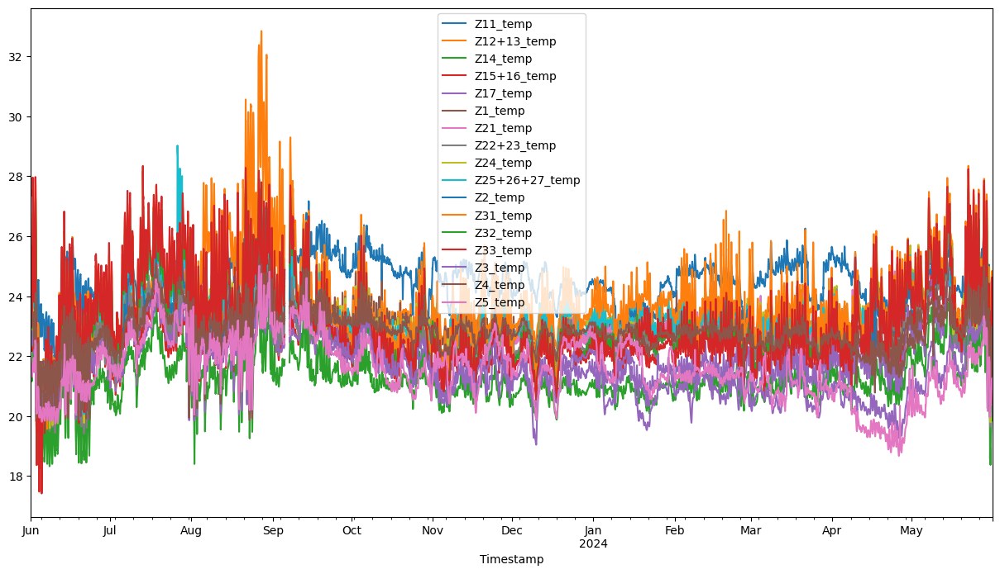

In [59]:
#define a threshold based on the data (assume sensor error)
#define the function to assign all stuck values to null values
def replace_stuck_values_with_nan(series, threshold=5):
    replaced_values = series.copy()
    count = 1  # Counter for consecutive same values
    for i in range(1, len(series)):
        if series.iloc[i] == series.iloc[i - 1]:
            count += 1
        else:
            if count > threshold:  # Replace with NaN if the count exceeds the threshold
                replaced_values.iloc[i - count:i] = np.nan
            count = 1  # Reset counter if the current value is not the same

    if count > threshold:  # Check at the end of the series
        replaced_values.iloc[-count:] = np.nan

    return replaced_values


def replace_repeated_values_with_nan(df):
    for column in df.columns:
        # Find duplicated values in the column (keep=False marks all duplicates as True)
        duplicates = df[column].duplicated(keep=False)
        # Replace duplicates with NaN
        df.loc[duplicates, column] = np.nan
    return df

for column in combined_df.columns:
    combined_df[column] = replace_stuck_values_with_nan(combined_df[column], threshold=5)
    
combined_df.plot(figsize=(15, 8))

In [60]:
combined_df.isna().sum()

Z11_temp          49
Z12+13_temp       49
Z14_temp          49
Z15+16_temp       49
Z17_temp          49
Z1_temp           49
Z21_temp          49
Z22+23_temp       49
Z24_temp          49
Z25+26+27_temp    49
Z2_temp           49
Z31_temp          49
Z32_temp          49
Z33_temp          49
Z3_temp           49
Z4_temp           49
Z5_temp           49
dtype: int64

In [61]:
#Missing data check
def find_nan_sequences(series):
    is_nan = series.isna()
    if is_nan.any():
        start = end = None
        for i, val in enumerate(is_nan):
            if val and start is None:
                start = i
            elif not val and start is not None:
                end = i - 1
                yield (series.index[start], series.index[end])
                start = end = None
        if start is not None:
            yield (series.index[start], series.index[-1])

# Find and print start and end indices of NaN sequences in each column
empDF = pd.DataFrame()
LstN = []
LstS = []
LstE = []

for column in combined_df.columns:
    for start, end in find_nan_sequences(combined_df[column]):
        print(f"Missing period:'{column}' from {start} to {end}")
        LstN.append(column)
        LstS.append(start)
        LstE.append(end)
        
empDF["names"] = LstN
empDF["start"] = LstS
empDF["end"] = LstE

Missing period:'Z11_temp' from 2023-07-29 04:00:00-04:00 to 2023-07-29 04:00:00-04:00
Missing period:'Z11_temp' from 2023-09-05 14:00:00-04:00 to 2023-09-07 08:00:00-04:00
Missing period:'Z11_temp' from 2024-02-26 14:00:00-05:00 to 2024-02-26 17:00:00-05:00
Missing period:'Z11_temp' from 2024-03-02 05:00:00-05:00 to 2024-03-02 05:00:00-05:00
Missing period:'Z12+13_temp' from 2023-07-29 04:00:00-04:00 to 2023-07-29 04:00:00-04:00
Missing period:'Z12+13_temp' from 2023-09-05 14:00:00-04:00 to 2023-09-07 08:00:00-04:00
Missing period:'Z12+13_temp' from 2024-02-26 14:00:00-05:00 to 2024-02-26 17:00:00-05:00
Missing period:'Z12+13_temp' from 2024-03-02 05:00:00-05:00 to 2024-03-02 05:00:00-05:00
Missing period:'Z14_temp' from 2023-07-29 04:00:00-04:00 to 2023-07-29 04:00:00-04:00
Missing period:'Z14_temp' from 2023-09-05 14:00:00-04:00 to 2023-09-07 08:00:00-04:00
Missing period:'Z14_temp' from 2024-02-26 14:00:00-05:00 to 2024-02-26 17:00:00-05:00
Missing period:'Z14_temp' from 2024-03-02 

In [62]:
empDF.to_csv(r'C:\Users\Sang\OneDrive - Harvard University\CGBC\DataRelease\Final_Processing_Code_2024\Missing Intervals\Year4\Missing_periods_ZT_Year4.csv', index=False)

In [63]:
combined_df.to_csv(r'C:\Users\Sang\OneDrive - Harvard University\CGBC\DataRelease\Final_Processing_Code_2024\Processed\Desigo\Year4\Zone_ZT_Year4.csv', index=True)